>## <b> Evaluation Project 7 : Rainfall Prediction - Weather Forecasting </b>
<b><em> By: Ms. Yashshree bawiskar </em></b>

<b><em> Batch: 1838 </em></b>

## Rainfall Prediction - Weather Forecasting

### Problem Statement:

**Rain Prediction –Weather forecasting**

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:
 
1. Problem Statement: 
a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.


Dataset available below

Downlaod Files:
https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv
https://github.com/dsrscientist/dataset3

## Importing required Liabaries

In [1]:
import pandas as pd # for data wrangling purpose
import numpy as np # Basic computation library
import seaborn as sns # For Visualization 
import matplotlib.pyplot as plt # ploting package
%matplotlib inline
import warnings # Filtering warnings
warnings.filterwarnings('ignore')

In [2]:
# Importing Insurance Claims dataset Csv file using pandas
df=pd.read_csv('weatherAUS.csv')

In [3]:
print('No of Rows:',df.shape[0])
print('No of Columns:',df.shape[1])
pd.set_option('display.max_columns', None) # This will enable us to see truncated columns
pd.set_option('display.max_rows', None) # This will enable us to see truncated rows
df.head()

No of Rows: 8425
No of Columns: 23


,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [4]:
# to get the columns name
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

## Dataset Description:

In the given dataset we have 23 no. features which are as per below:


1.Date - The date of observation

2.Location -The common name of the location of the weather station

3.MinTemp -The minimum temperature in degrees celsius.

4.MaxTemp -The maximum temperature in degrees celsius.

5.Rainfall -The amount of rainfall recorded for the day in mm

6.Evaporation -The so-called Class A pan evaporation (mm) in the 24 hours to 9am

7.Sunshine -The number of hours of bright sunshine in the day.

8.WindGustDir- The direction of the strongest wind gust in the 24 hours to midnight

9.WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight

10.WindDir9am -Direction of the wind at 9am

11.WindDir3pm -Direction of the wind at 3pm

12.WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am

13.WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm

14.Humidity9am -Humidity (percent) at 9am

15.Humidity3pm -Humidity (percent) at 3pm

16.Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am

17.Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm

18.Cloud9am - Fraction of sky obscured by cloud at 9am

19.Cloud3pm -Fraction of sky obscured by cloud

20.Temp9am-Temperature (degrees C) at 9am

21.Temp3pm -Temperature (degrees C) at 3pm

22.RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0.

23.RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".


## Let's do Data Integrity Check

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

In [6]:
# Sort columns by datatypes
df.columns.to_series().groupby(df.dtypes).groups

{float64: ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm'], object: ['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']}

### Conclusion:
- Above is the list of datatypes which we have. 
- In the list of float data we have 16 No. of features.
- In the list of object  data we have 7 No. of features.



## Let's check for duplicate values if any available

In [7]:
df.duplicated('Rainfall').sum()

8174

In [8]:
df.duplicated().sum()

1663

<b> Let's check if any whitespace, 'NA' or '-' exist in dataset. </b>

In [9]:
df.isin([' ','NA','-']).sum().any()

False

In [10]:
df.isin(['?']).sum().any()

False

## Missing value check

In [11]:
#Finding what percentage of data is missing from the dataset
missing_values = df.isnull().sum().sort_values(ascending = False)
percentage_missing_values =(missing_values/len(df))*100
print(pd.concat([missing_values, percentage_missing_values], axis =1, keys =['Missing Values', '% Missing data']))

               Missing Values  % Missing data
Sunshine                 3994       47.406528
Evaporation              3512       41.685460
Cloud3pm                 2455       29.139466
Cloud9am                 2421       28.735905
Pressure3pm              1312       15.572700
Pressure9am              1309       15.537092
WindGustDir               991       11.762611
WindGustSpeed             991       11.762611
WindDir9am                829        9.839763
WindDir3pm                308        3.655786
RainToday                 240        2.848665
Rainfall                  240        2.848665
RainTomorrow              239        2.836795
WindSpeed3pm              107        1.270030
Humidity3pm               102        1.210682
Temp3pm                    96        1.139466
WindSpeed9am               76        0.902077
MinTemp                    75        0.890208
MaxTemp                    60        0.712166
Humidity9am                59        0.700297
Temp9am                    56     

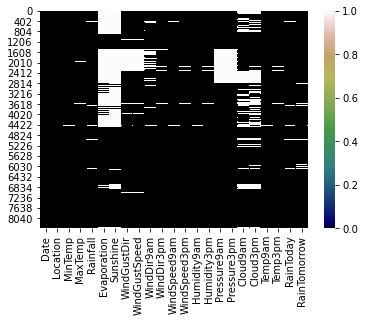

In [12]:
# Heatmap of missing value
sns.heatmap(df.isnull(),cmap="gist_earth")
plt.show()

## Here  almost all features having missing data except Date and Location

##  Imputation of Missing Value

In [13]:
#Filling null values in MinTemp with it's mean
df['MinTemp'] = df['MinTemp'].fillna(df['MinTemp'].mean())

#Filling null values in MaxTemp with it's mean
df['MaxTemp'] = df['MaxTemp'].fillna(df['MaxTemp'].mean())

#Fillinf null values in Rainfall with it's mode, as most of the rows have 0 rainfall.
df['Rainfall'] = df['Rainfall'].fillna(df['Rainfall'].mode()[0])

#Filling null values in Evaporation with it's mean
df['Evaporation'] = df['Evaporation'].fillna(df['Evaporation'].mean())

#Filling null values in Sunshine with it's mean
df['Sunshine'] = df['Sunshine'].fillna(df['Sunshine'].mean())

#Filling null values in WindGustDir with it's mode
df['WindGustDir'] = df['WindGustDir'].fillna(df['WindGustDir'].mode()[0])

#Filling null values in WindGustSpeed with it's mean
df['WindGustSpeed'] = df['WindGustSpeed'].fillna(df['WindGustSpeed'].mean())

#Filling null values in WindDir9am with it's mode
df['WindDir9am'] = df['WindDir9am'].fillna(df['WindDir9am'].mode()[0])

#Filling null values in WindDir3pm with it's mode
df['WindDir3pm'] = df['WindDir3pm'].fillna(df['WindDir3pm'].mode()[0])

#Filling null values in WindSpeed9am with it's mean
df['WindSpeed9am'] = df['WindSpeed9am'].fillna(df['WindSpeed9am'].mean())

#Filling null values in WindSpeed3pm with it's mean
df['WindSpeed3pm'] = df['WindSpeed3pm'].fillna(df['WindSpeed3pm'].mean())

#Filling null values in Humidity9am with it's mean
df['Humidity9am'] = df['Humidity9am'].fillna(df['Humidity9am'].mean())

#Filling null values in Humidity3pm with it's mean
df['Humidity3pm'] = df['Humidity3pm'].fillna(df['Humidity3pm'].mean())

#Filling null values in Pressure9am with it's mean
df['Pressure9am'] = df['Pressure9am'].fillna(df['Pressure9am'].mean())

#Filling null values in Pressure3pm with it's mean
df['Pressure3pm'] = df['Pressure3pm'].fillna(df['Pressure3pm'].mean())

#Filling null values in Cloud9am with it's mean
df['Cloud9am'] = df['Cloud9am'].fillna(df['Cloud9am'].mean())

#Filling null values in Cloud3pm with it's mean
df['Cloud3pm'] = df['Cloud3pm'].fillna(df['Cloud3pm'].mean())

#Filling null values in Temp9am with it's mean
df['Temp9am'] = df['Temp9am'].fillna(df['Temp9am'].mean())

#Filling null values in Temp3pm with it's mean
df['Temp3pm'] = df['Temp3pm'].fillna(df['Temp3pm'].mean())

#Filling null values in Temp3pm with it's mean
df['Temp3pm'] = df['Temp3pm'].fillna(df['Temp3pm'].mean())

#Filling null values in RainToday with it's mode
df['RainToday'] = df['RainToday'].fillna(df['RainToday'].mode()[0])

#Filling null values in RainTomorrow with it's mode
df['RainTomorrow'] = df['RainTomorrow'].fillna(df['RainTomorrow'].mode()[0])

__Here we  have filled the missing value using  mean, mode__

In [14]:
#Finding what percentage of data is missing from the dataset
missing_values = df.isnull().sum().sort_values(ascending = False)
percentage_missing_values =(missing_values/len(df))*100
print(pd.concat([missing_values, percentage_missing_values], axis =1, keys =['Missing Values', '% Missing data']))

               Missing Values  % Missing data
Date                        0             0.0
WindSpeed3pm                0             0.0
RainToday                   0             0.0
Temp3pm                     0             0.0
Temp9am                     0             0.0
Cloud3pm                    0             0.0
Cloud9am                    0             0.0
Pressure3pm                 0             0.0
Pressure9am                 0             0.0
Humidity3pm                 0             0.0
Humidity9am                 0             0.0
WindSpeed9am                0             0.0
Location                    0             0.0
WindDir3pm                  0             0.0
WindDir9am                  0             0.0
WindGustSpeed               0             0.0
WindGustDir                 0             0.0
Sunshine                    0             0.0
Evaporation                 0             0.0
Rainfall                    0             0.0
MaxTemp                     0     

## Missing value check after imputation using heatmap

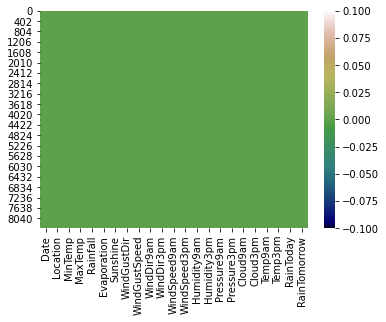

In [15]:
# Heatmap of missing value
sns.heatmap(df.isnull(),cmap="gist_earth")
plt.show()

__Now we dont have any missing value.__

In [16]:
df.nunique()

Date             3004
Location           12
MinTemp           286
MaxTemp           332
Rainfall          250
Evaporation       117
Sunshine          141
WindGustDir        16
WindGustSpeed      53
WindDir9am         16
WindDir3pm         16
WindSpeed9am       35
WindSpeed3pm       36
Humidity9am        91
Humidity3pm        95
Pressure9am       385
Pressure3pm       375
Cloud9am           10
Cloud3pm           10
Temp9am           305
Temp3pm           329
RainToday           2
RainTomorrow        2
dtype: int64

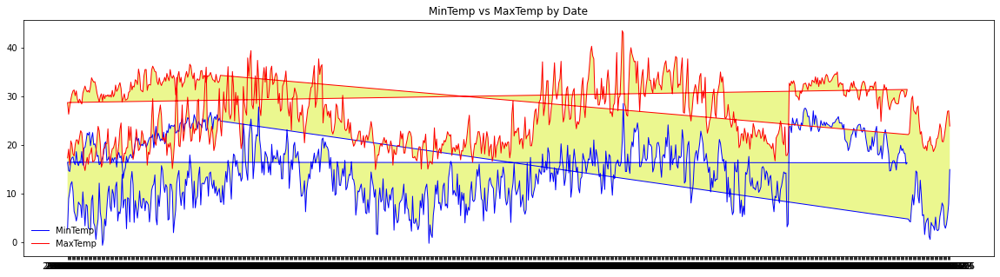

In [17]:
df_dateplot = df.iloc[-950:,:]
plt.figure(figsize=[20,5])
plt.plot(df_dateplot['Date'],df_dateplot['MinTemp'],color='blue',linewidth=1, label= 'MinTemp')
plt.plot(df_dateplot['Date'],df_dateplot['MaxTemp'],color='red',linewidth=1, label= 'MaxTemp')
plt.fill_between(df_dateplot['Date'],df_dateplot['MinTemp'],df_dateplot['MaxTemp'], facecolor = '#EBF78F')
plt.title('MinTemp vs MaxTemp by Date')
plt.legend(loc='lower left', frameon=False)
plt.show()

In [18]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.193305,23.859976,2.725982,5.389395,7.632205,40.174469,13.847646,18.533662,67.822496,51.249790,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.442934
std,5.379488,6.114516,10.319872,3.852004,2.825451,13.776101,10.128579,9.704759,16.774231,18.311894,6.275759,6.217451,2.429205,2.299419,5.608301,5.945849
min,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,0.000000,0.000000,1.900000,7.300000
25%,9.300000,19.300000,0.000000,4.000000,7.632205,31.000000,6.000000,11.000000,56.000000,39.000000,1014.000000,1011.400000,3.000000,3.000000,13.800000,18.100000
50%,13.200000,23.300000,0.000000,5.389395,7.632205,40.174469,13.000000,19.000000,68.000000,51.000000,1017.640233,1015.236075,4.566622,4.503183,17.762015,22.000000
75%,17.300000,28.000000,0.800000,5.389395,8.900000,48.000000,20.000000,24.000000,80.000000,63.000000,1021.300000,1018.800000,7.000000,7.000000,21.900000,26.300000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,8.000000,8.000000,39.400000,44.100000


## Let's do the Feature Engineering

Creating 3 new columns of day/date month and year

In [19]:
df['Date'] = pd.to_datetime(df['Date'])

In [20]:
##Extracting Day from Date_of_journey feature
df['Day'] = pd.to_datetime(df.Date,format="%d/%m/%Y").dt.day

#Extracting Month from Date_of_journey feature
df['Month'] = pd.to_datetime(df.Date, format="%d/%m/%Y").dt.month

#Extracting Year from Date_of_journey feature
df['Year'] = pd.to_datetime(df.Date, format="%d/%m/%Y").dt.year

# droping the feature of date as we have create 3 new features
df.drop(columns=['Date'],axis=1,inplace=True)

## Let's Try to explore our target variable and other feature

## Univeriate Analysis

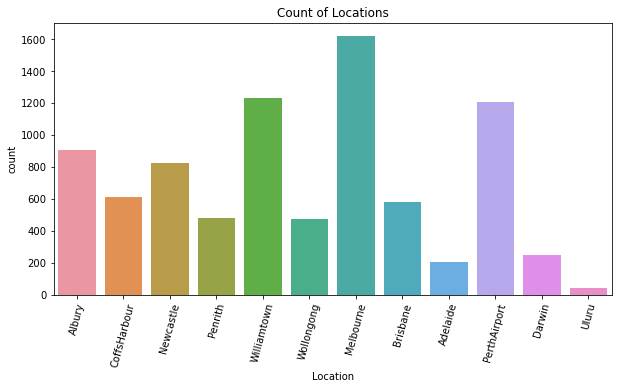

In [21]:
# Visualizing the various Locations present in the dataset
plt.figure(figsize=(10,5))
sns.countplot(df["Location"])
plt.title("Count of Locations")
plt.xticks(rotation=75)
plt.show()

###  We have the highest rainfall data from 'Melbourbne' and least from 'Uluru'

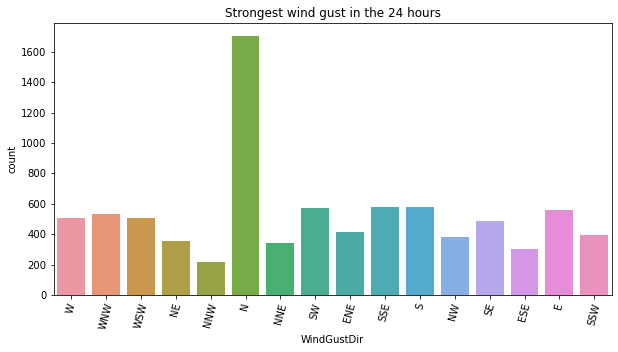

In [22]:
# Visualizing the direction of the strongest wind gust in the 24 hours to midnight
plt.figure(figsize=(10,5))
sns.countplot(df["WindGustDir"])
plt.title("Strongest wind gust in the 24 hours")
plt.xticks(rotation=75)
plt.show()


## We can see that the wind gust was strongest towards the north, followed by the SW, SSE, S,WNW.

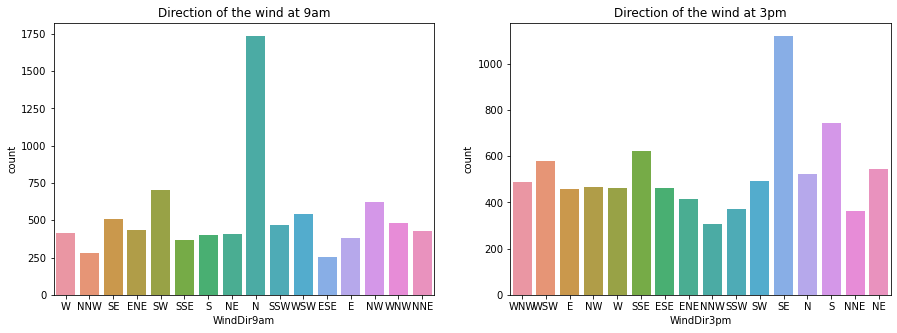

In [23]:
#Visualization of wind at 9 am and 3pm.
plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('Direction of the wind at 9am')
sns.countplot(df['WindDir9am'])
plt.subplot(1,2,2)
plt.title('Direction of the wind at 3pm')
sns.countplot(df['WindDir3pm'])
plt.show()

### In the plots we can clearly see that the wing direction was towards the N at 9am and in the SE at 3pm

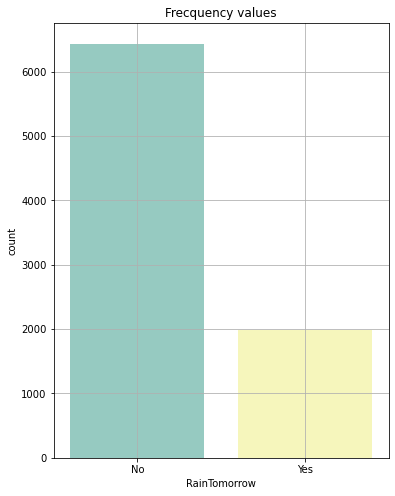

In [24]:
plt.ax =plt.subplots(figsize=(6,8))
ax=sns.countplot(x='RainTomorrow',data=df,palette="Set3")
#plt.xticks(rotation=90)
plt.grid()
plt.title('Frecquency values');

<AxesSubplot:title={'center':'RainToday'}, xlabel='RainToday', ylabel='count'>

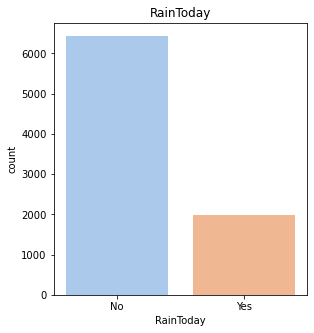

In [25]:
#Visualization of Rainfall today and tomorrow:
plt.figure(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.title('RainToday')
sns.countplot(df['RainToday'],palette='pastel')

#### We can hardy see any difference in the rainfall today and tomorrow, we will see the corelation later and do the feature selection

## Distributing data into two categories Numerical and Categorical

In [26]:
#checking categorical features
Category=[]
for i in df.dtypes.index:
    if df.dtypes[i]=='object':
        Category.append(i)
print(Category)

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


above is the list of Categorical features.

In [27]:
# checking for numerical features
Numerical=[]
for i in df.dtypes.index:
    if df.dtypes[i]!='object':
        Numerical.append(i)
print(Numerical)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Day', 'Month', 'Year']


Above list have Numerical Features

## Let's See the Distribution of Numerical features

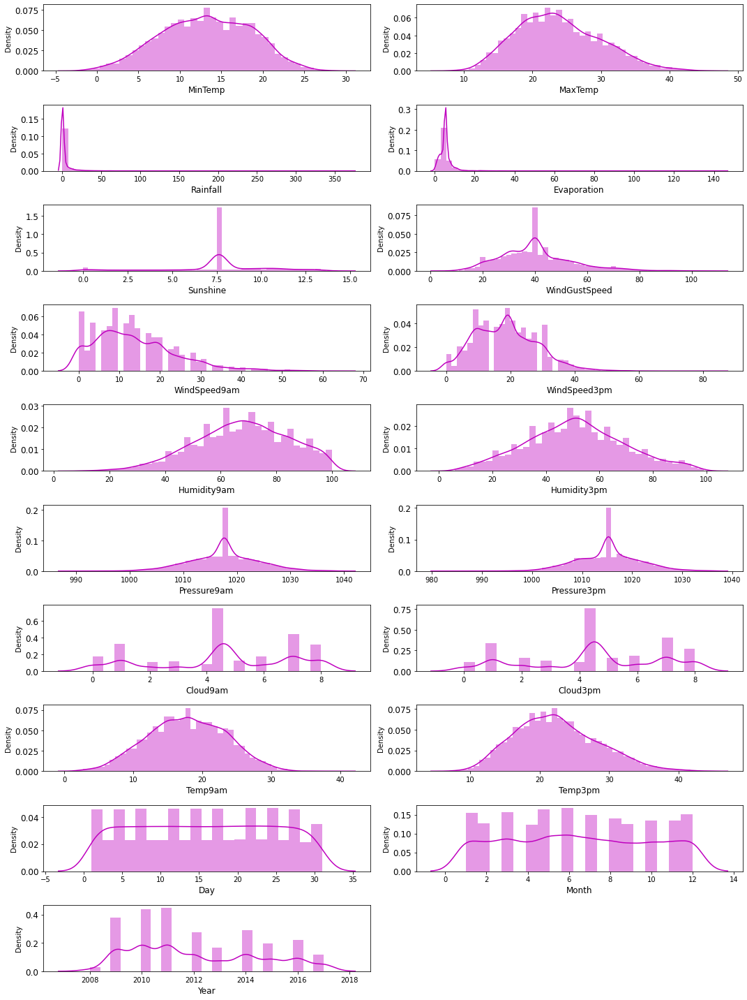

In [28]:
plt.figure(figsize=(15,20),facecolor='white')
plotnumber=1
for column in Numerical:
    if plotnumber<=20:
        ax=plt.subplot(10,2,plotnumber)
        sns.distplot(df[column],color="m")
        plt.xlabel(column,fontsize=12)
        plt.yticks(rotation=0,fontsize=12)
    plotnumber+=1
plt.tight_layout()

## Obervations:

- From the graphs we can say that the dataset is not normally distributed.

- Min Temp is normally distributed

- Max Temp is slightly skewed right

- Rainfall is skewed right

- Evaporation is skewed right

- Sunshine is not normally distributed

- WindGustSpeed, WindSpeed9am,WindSpeed3pm is skewed right

- Humidity9am is slightly skewed left and Humidity3pm is normally distributed.

- Pressure9am, Pressure3pm, Cloud9am, Cloud3pm,Temp9am,Temp3pm,Day, Month and Year has no skewness however the data is not distributed normally.

## Bivariate Analysis

### Checking the relation between the features and the two targerts we have

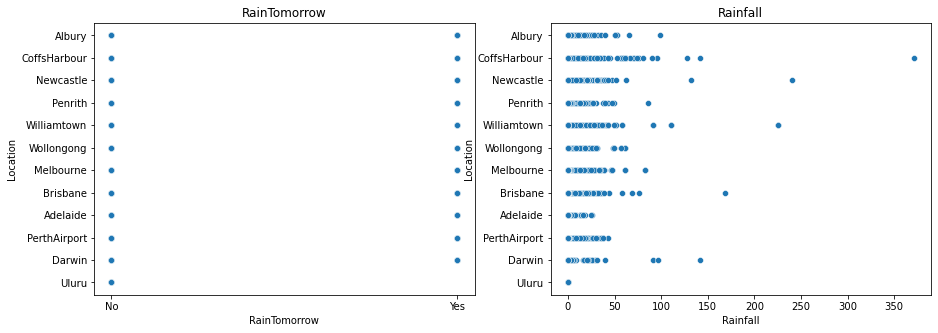

In [29]:
#checking the corelation between location with both the targets (Rainfall and Rain Tommorow) using scatterplot

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('RainTomorrow')
sns.scatterplot(x='RainTomorrow',y='Location',data=df)
plt.subplot(1,2,2)
plt.title('Rainfall')
sns.scatterplot(x='Rainfall',y='Location',data=df)
plt.show()

**As we can see that location does not have any major impact on the prediction of rainfall, however we will not drop the feature as prediction is done as per reigion.**

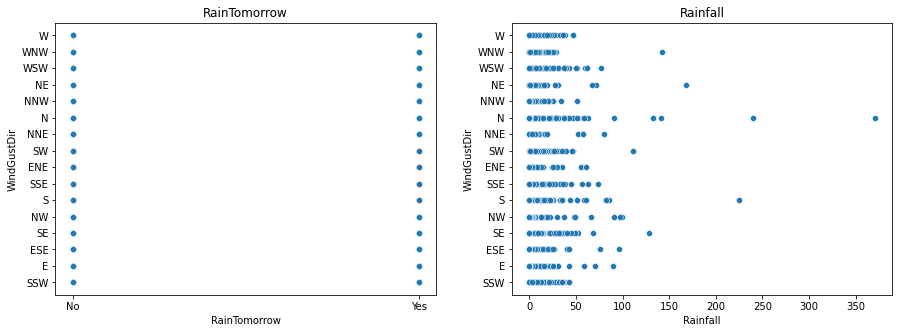

In [30]:
#checking the corelation between WindGustDir with both the targets (Rainfall and Rain Tommorow) using scatterplot

plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.title('RainTomorrow')
sns.scatterplot(x='RainTomorrow',y='WindGustDir',data=df)
plt.subplot(1,2,2)
plt.title('Rainfall')
sns.scatterplot(x='Rainfall',y='WindGustDir',data=df)
plt.show()

**From this graph we can observe that there is  no linear relation exist in both features of target**

<AxesSubplot:xlabel='WindDir3pm', ylabel='Rainfall'>

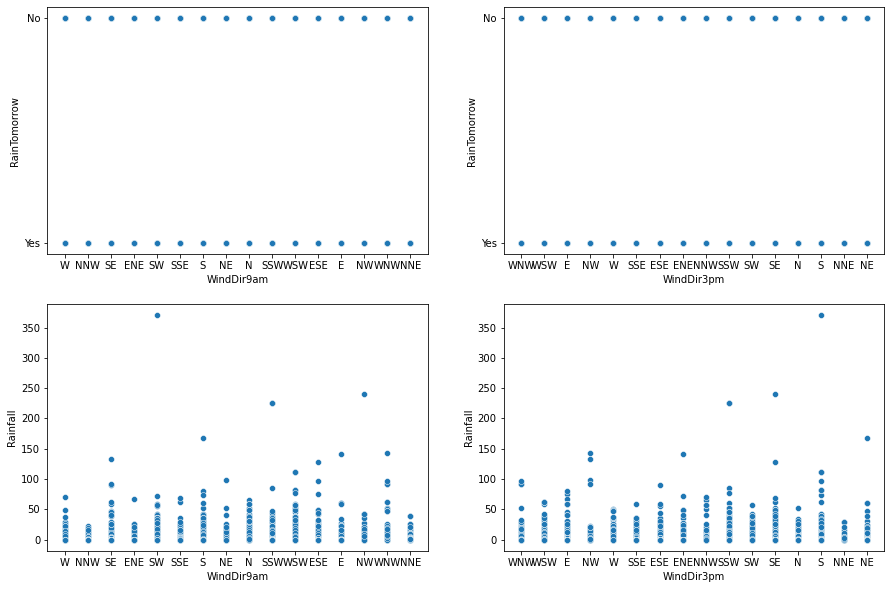

In [31]:
fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between WindDir9am and RainTomorrow
sns.scatterplot(x='WindDir9am',y='RainTomorrow',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between WindDir3pm and RainTomorrow
sns.scatterplot(x='WindDir3pm',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between WindDir9am and Rainfall
sns.scatterplot(x='WindDir9am',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between WindDir3pm and Rainfall
sns.scatterplot(x='WindDir3pm',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

**Here, doesnot exist linear relation or multi linear relation in any feature which we have considered in the above plot**

<AxesSubplot:xlabel='MaxTemp', ylabel='Rainfall'>

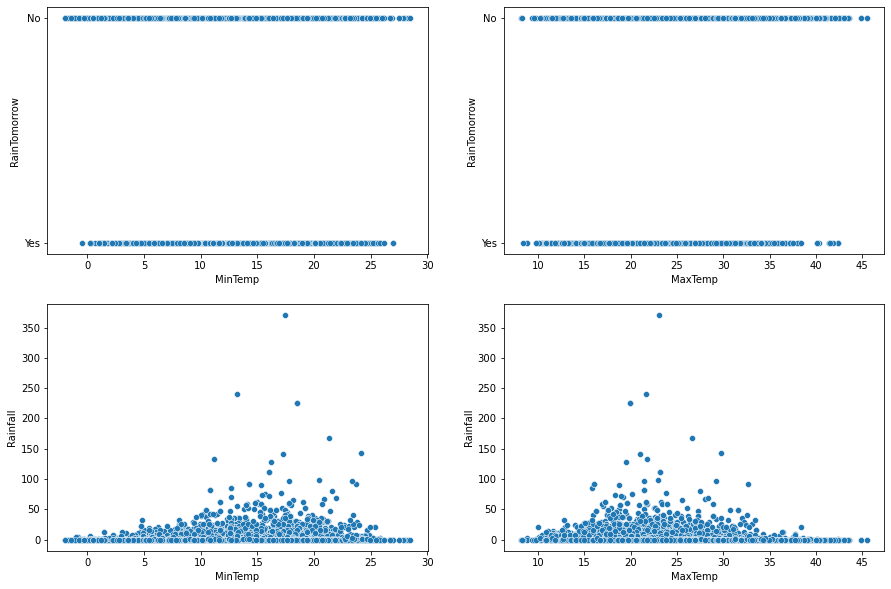

In [32]:
fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between minimum temperature and RainTomorrow
sns.scatterplot(x='MinTemp',y='RainTomorrow',ax=axes[0,0],palette="green",data=df)

#checking the relation between max temperature and RainTomorrow
sns.scatterplot(x='MaxTemp',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between minimum temperature and Rainfall
sns.scatterplot(x='MinTemp',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between max temperature and Rainfall
sns.scatterplot(x='MaxTemp',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

#### It can be cleary difine that there is no linear relation exsit  in between  max temp and min temp with our target features.

<AxesSubplot:xlabel='Sunshine', ylabel='Rainfall'>

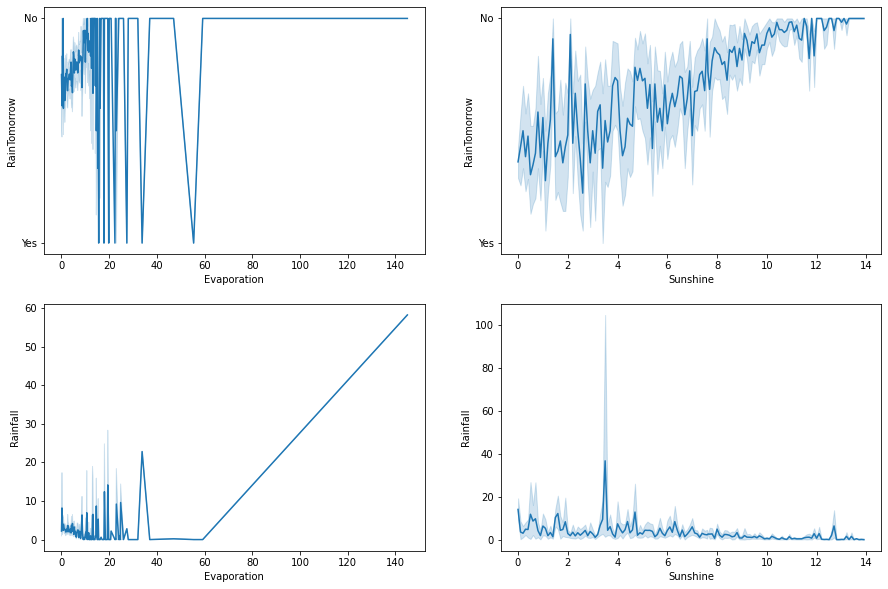

In [33]:
ig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between Evaporation and RainTomorrow
sns.lineplot(x='Evaporation',y='RainTomorrow',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between Sunshine and RainTomorrow
sns.lineplot(x='Sunshine',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between Evaporation and Rainfall
sns.lineplot(x='Evaporation',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between Sunshine and Rainfall
sns.lineplot(x='Sunshine',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

<AxesSubplot:xlabel='WindSpeed3pm', ylabel='Rainfall'>

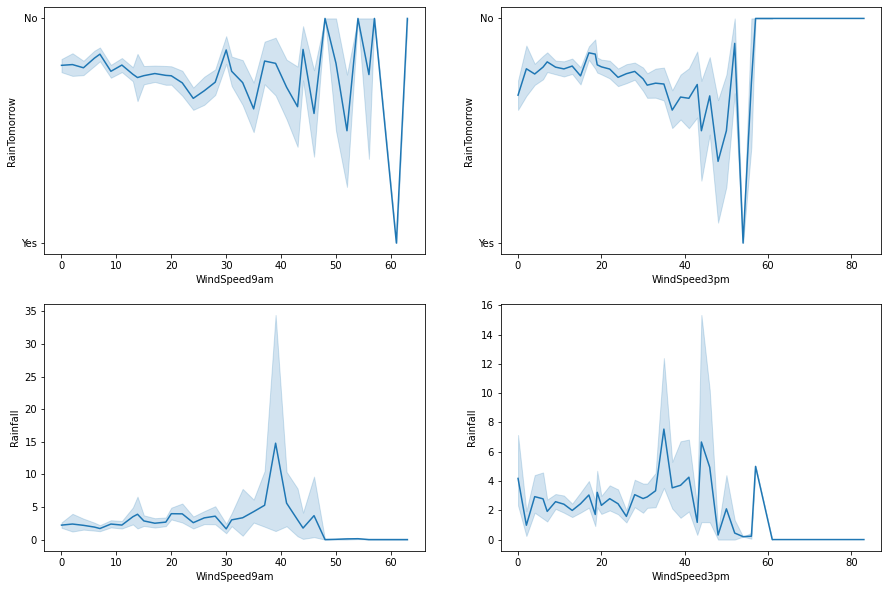

In [34]:
fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between WindSpeed9am and RainTomorrow
sns.lineplot(x='WindSpeed9am',y='RainTomorrow',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between WindSpeed3pm and RainTomorrow
sns.lineplot(x='WindSpeed3pm',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between WindSpeed9am and Rainfall
sns.lineplot(x='WindSpeed9am',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between WindSpeed3pm and Rainfall
sns.lineplot(x='WindSpeed3pm',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

<AxesSubplot:xlabel='Humidity3pm', ylabel='Rainfall'>

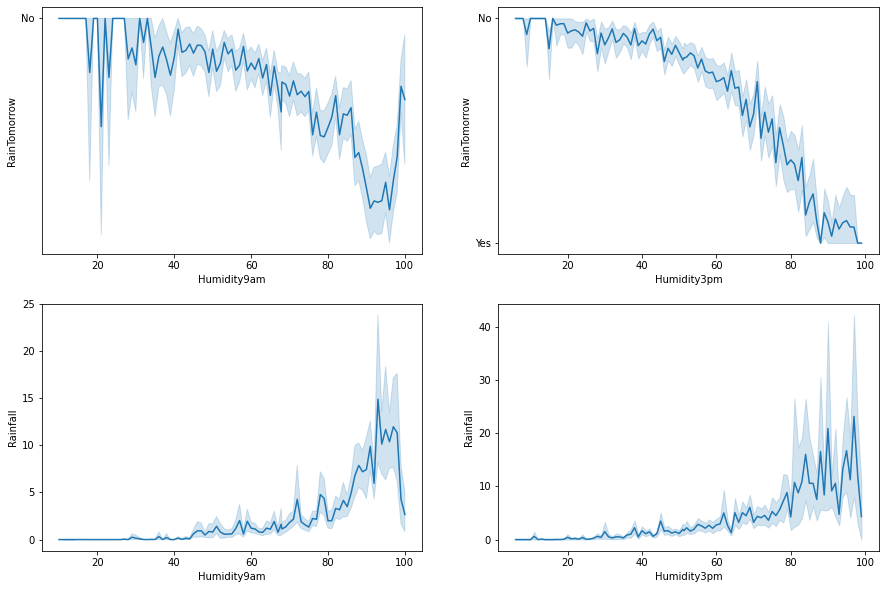

In [35]:
fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between Humidity9am and RainTomorrow
sns.lineplot(x='Humidity9am',y='RainTomorrow',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between Humidity3pm and RainTomorrow
sns.lineplot(x='Humidity3pm',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between Humidity9am and Rainfall
sns.lineplot(x='Humidity9am',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between Humidity3pm and Rainfall
sns.lineplot(x='Humidity3pm',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

**Here we can see a inverse relation in humidity with rain tomorrow and positive relation between humidity and Rainfall**

<AxesSubplot:xlabel='Pressure3pm', ylabel='Rainfall'>

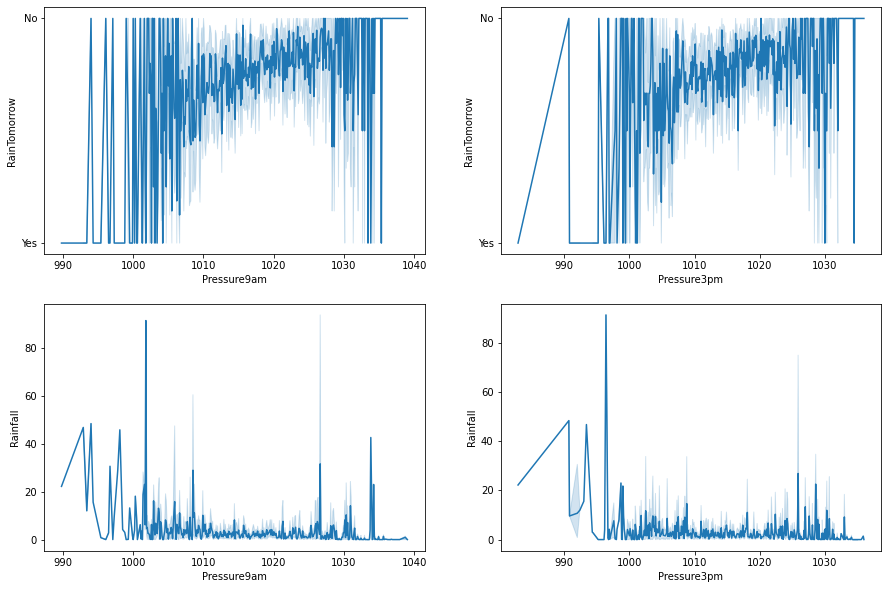

In [36]:
fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between Pressure9am and RainTomorrow
sns.lineplot(x='Pressure9am',y='RainTomorrow',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between Pressure3pm and RainTomorrow
sns.lineplot(x='Pressure3pm',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between Pressure9am and Rainfall
sns.lineplot(x='Pressure9am',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between Pressure3pm and Rainfall
sns.lineplot(x='Pressure3pm',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

<AxesSubplot:xlabel='Pressure3pm', ylabel='Rainfall'>

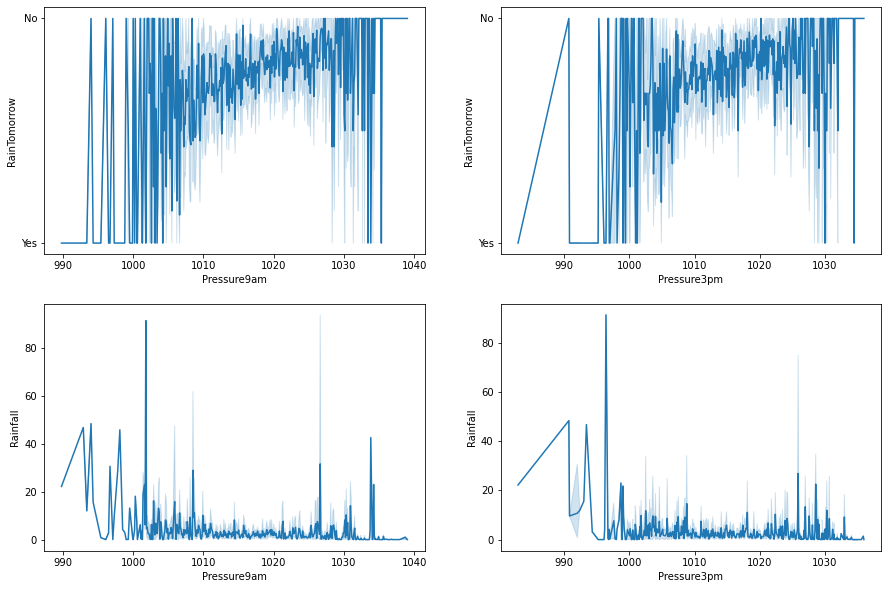

In [37]:
fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between Pressure9am and RainTomorrow
sns.lineplot(x='Pressure9am',y='RainTomorrow',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between Pressure3pm and RainTomorrow
sns.lineplot(x='Pressure3pm',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between Pressure9am and Rainfall
sns.lineplot(x='Pressure9am',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between Pressure3pm and Rainfall
sns.lineplot(x='Pressure3pm',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

**The graph shows a linear relationship, and inverse relation between could and rain tomorrow and a positive relation between could and rainfall**

<AxesSubplot:xlabel='Temp3pm', ylabel='Rainfall'>

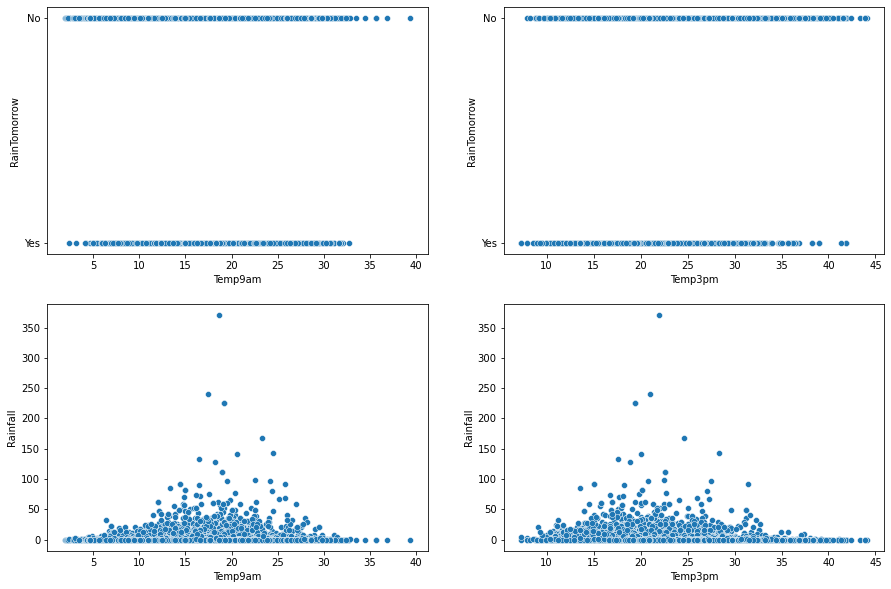

In [38]:
fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between Temp9am and RainTomorrow
sns.scatterplot(x='Temp9am',y='RainTomorrow',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between Temp3pm and RainTomorrow
sns.scatterplot(x='Temp3pm',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between Temp9am and Rainfall
sns.scatterplot(x='Temp9am',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between Temp3pm and Rainfall
sns.scatterplot(x='Temp3pm',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

**There is no linear relation that is seen in these plots.**

<AxesSubplot:xlabel='Year', ylabel='Rainfall'>

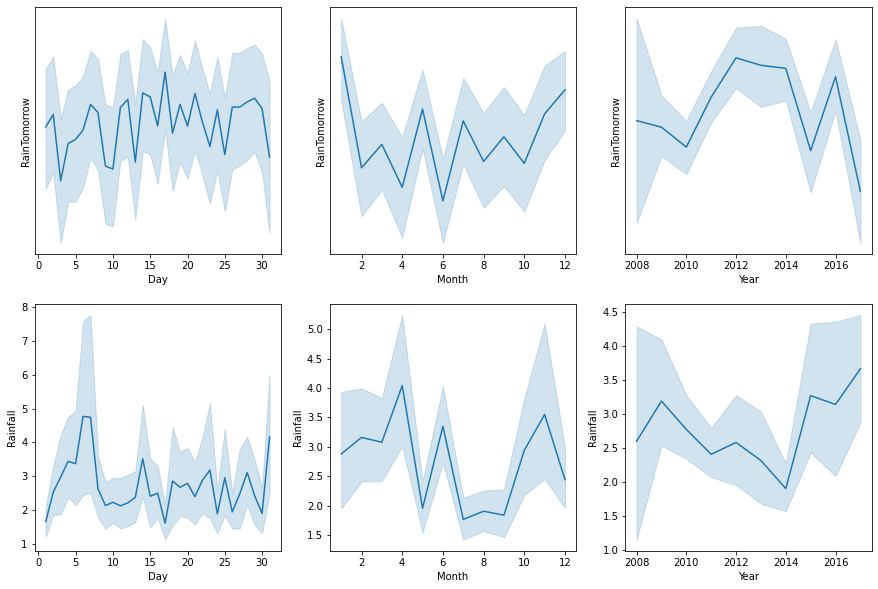

In [39]:
fig,axes=plt.subplots(2,3,figsize=(15,10))

#checking the relation between Day and RainTomorrow
sns.lineplot(x='Day',y='RainTomorrow',ax=axes[0,0],palette="green",data=df)

#checking the relation between Month and RainTomorrow
sns.lineplot(x='Month',y='RainTomorrow',ax=axes[0,1],palette="green",data=df)

#checking the relation between Year and RainTomorrow
sns.lineplot(x='Year',y='RainTomorrow',ax=axes[0,2],palette="green",data=df)

#checking the relation between Day and Rainfall
sns.lineplot(x='Day',y='Rainfall',ax=axes[1,0],palette="purple",data=df)

#checking the relation between Month and Rainfall
sns.lineplot(x='Month',y='Rainfall',ax=axes[1,1],palette="purple",data=df)

#checking the relation between Year and Rainfall
sns.lineplot(x='Year',y='Rainfall',ax=axes[1,2],palette="purple",data=df)

**It can be clearly seen that there is no linear relationship.**

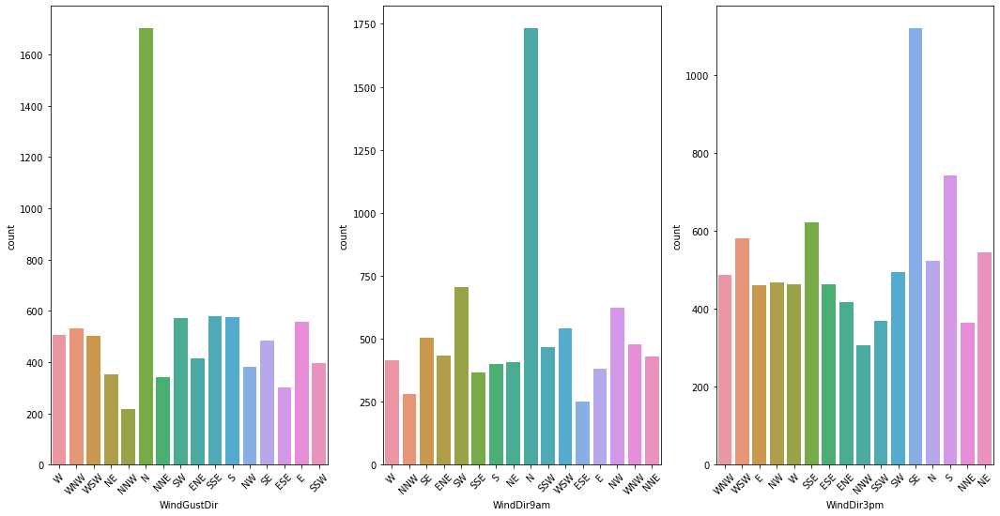

In [40]:
plt.figure(figsize=(18,9))
plt.subplot(131)
sns.countplot(x = 'WindGustDir',data=df)
plt.xticks(rotation=45)

plt.subplot(132)
sns.countplot(x = 'WindDir9am',data=df)
plt.xticks(rotation=45)

plt.subplot(133)
sns.countplot(x = 'WindDir3pm',data=df)
plt.xticks(rotation=45)

plt.show()

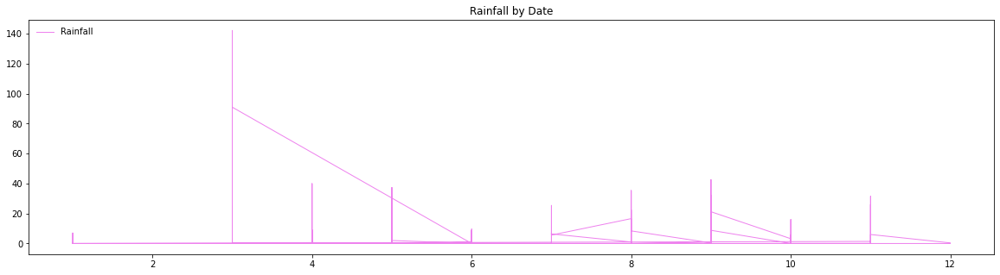

In [41]:
df_dateplot = df.iloc[-950:,:]
plt.figure(figsize=[20,5])
plt.plot(df_dateplot['Month'],df_dateplot['Rainfall'],color='violet', linewidth=1, label= 'Rainfall')
plt.legend(loc='upper left', frameon=False)
plt.title('Rainfall by Date')
plt.show()

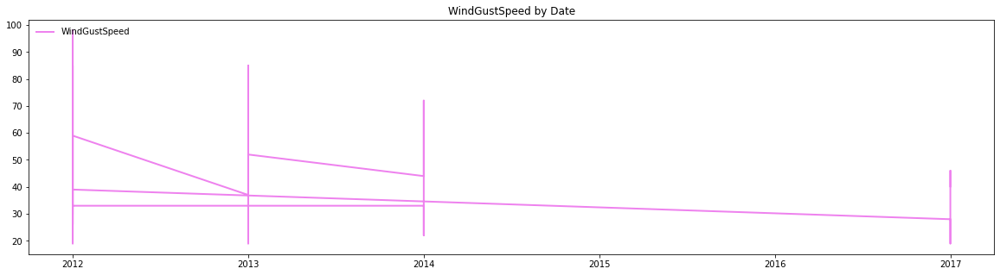

In [42]:
df_dateplot = df.iloc[-950:,:]
plt.figure(figsize=[20,5])
plt.plot(df_dateplot['Year'],df_dateplot['WindGustSpeed'],color='violet', linewidth=2, label= 'WindGustSpeed')
plt.legend(loc='upper left', frameon=False)
plt.title('WindGustSpeed by Date')
plt.show()

## Here we will check Correlation

In [43]:
df.corr()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Day,Month,Year
MinTemp,1.000000,0.717522,0.085723,0.254965,0.056184,0.230058,0.136872,0.178349,-0.130731,0.079048,-0.429432,-0.422991,0.091604,0.038414,0.887119,0.685520,0.009446,-0.245854,0.044123
MaxTemp,0.717522,1.000000,-0.087710,0.322405,0.378403,0.139998,0.013314,0.088172,-0.390976,-0.421879,-0.325721,-0.403258,-0.253968,-0.250132,0.866039,0.974506,0.015608,-0.163253,0.119772
Rainfall,0.085723,-0.087710,1.000000,0.024742,-0.167120,0.083374,0.048812,0.021654,0.227595,0.234938,-0.069604,-0.031268,0.183811,0.150187,-0.007351,-0.090768,-0.013029,-0.016258,0.004491
Evaporation,0.254965,0.322405,0.024742,1.000000,0.226001,0.136371,0.104294,0.101126,-0.213108,-0.161661,-0.177786,-0.189558,-0.062283,-0.108022,0.305264,0.315109,0.013597,0.004362,0.152708
Sunshine,0.056184,0.378403,-0.167120,0.226001,1.000000,-0.013778,-0.018069,0.030145,-0.360831,-0.440268,0.021887,-0.035863,-0.533391,-0.547304,0.250640,0.395324,0.004662,-0.006694,0.065374
WindGustSpeed,0.230058,0.139998,0.083374,0.136371,-0.013778,1.000000,0.600198,0.634939,-0.269593,-0.091860,-0.407139,-0.372651,0.023313,0.078631,0.202298,0.102199,-0.002876,0.051968,-0.042402
WindSpeed9am,0.136872,0.013314,0.048812,0.104294,-0.018069,0.600198,1.000000,0.560660,-0.358391,-0.110587,-0.174679,-0.138454,-0.000549,0.058198,0.109798,-0.002606,-0.003067,0.038427,-0.088489
WindSpeed3pm,0.178349,0.088172,0.021654,0.101126,0.030145,0.634939,0.560660,1.000000,-0.250953,-0.091004,-0.251697,-0.207544,0.005061,0.003295,0.184188,0.066087,-0.008957,0.049483,-0.051466
Humidity9am,-0.130731,-0.390976,0.227595,-0.213108,-0.360831,-0.269593,-0.358391,-0.250953,1.000000,0.633291,0.142374,0.173415,0.404742,0.296862,-0.378344,-0.382401,0.003799,-0.115530,0.099717
Humidity3pm,0.079048,-0.421879,0.234938,-0.161661,-0.440268,-0.091860,-0.110587,-0.091004,0.633291,1.000000,0.001629,0.070369,0.424348,0.439965,-0.130414,-0.491485,0.012512,-0.074256,-0.028920


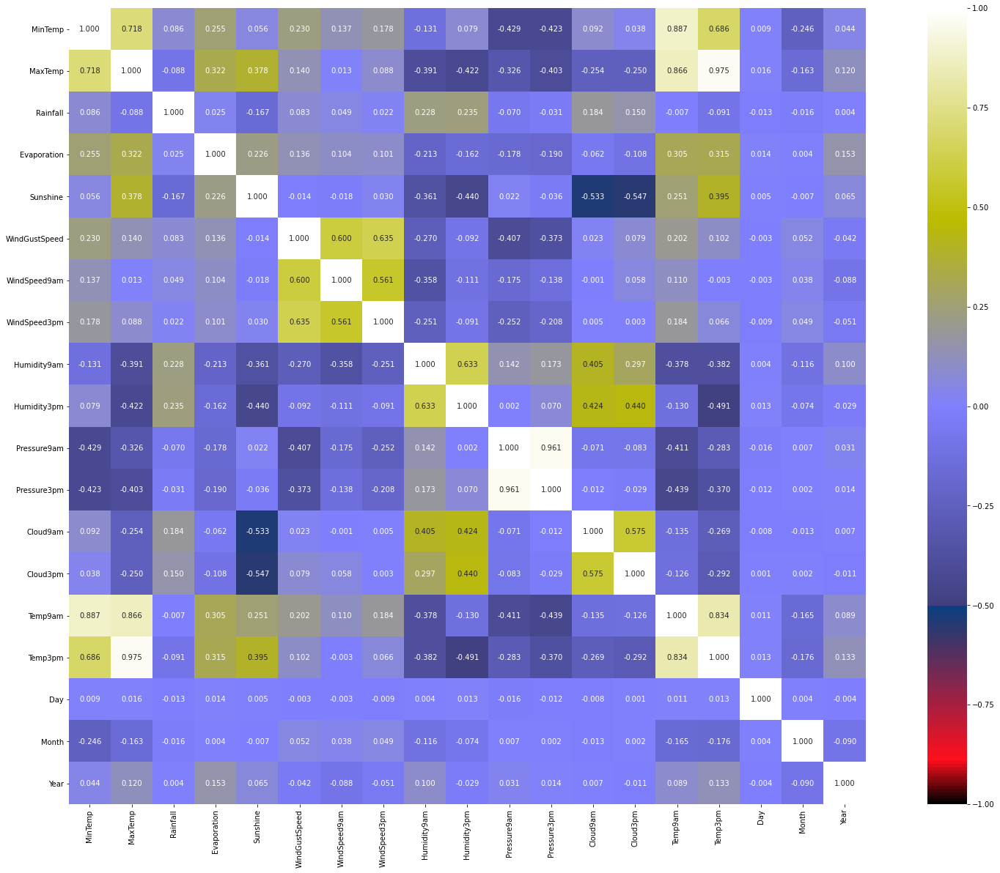

In [44]:
plt.figure(figsize=(30,20))
sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True, square=True, fmt='0.3f', cmap="gist_stern")
plt.show()

## Identification of Outliers

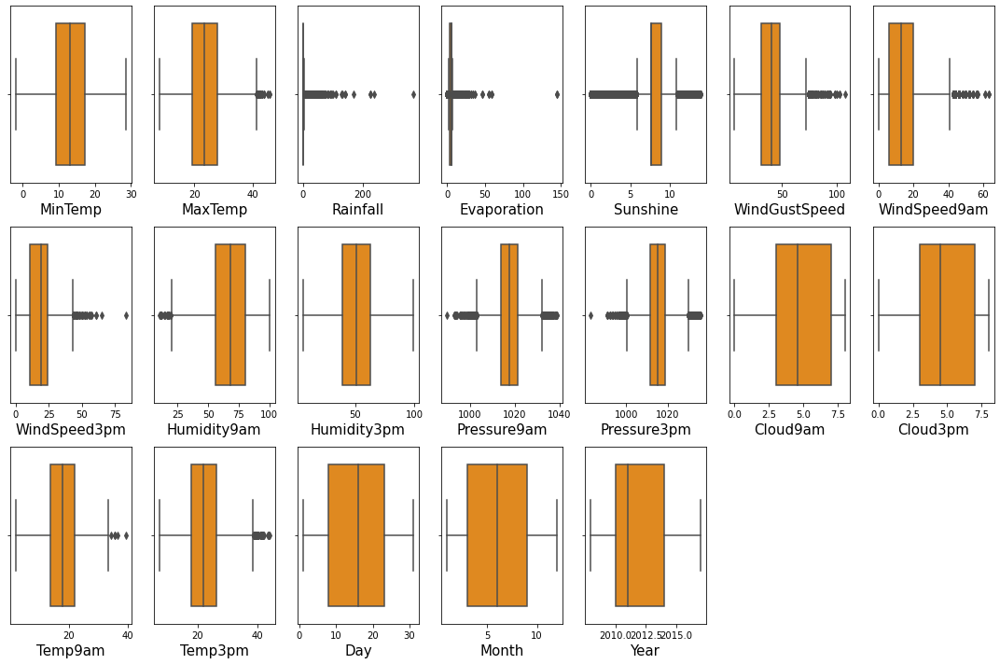

In [45]:
# Identifying the outliers using boxplot
plt.figure(figsize=(15,10),facecolor='white')
plotnumber=1
for column in Numerical:
    if plotnumber<=20:
        ax=plt.subplot(3,7,plotnumber)
        sns.boxplot(df[column],color="darkorange")
        plt.xlabel(column,fontsize=15)
    plotnumber+=1
plt.tight_layout()

**From the above boxplots, we can see that features having outliers are: MaxTemp, Rainfall, Evaporation, Sunshine, WindGustSpeed, WindSpeed9am,Windspeed3pm, Humidity9am, Pressure9am, Pressure3pm, Temp9am, Temp3pm**

In [46]:
df.columns

Index(['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow', 'Day', 'Month', 'Year'],
      dtype='object')

## Removing Outliers

In [47]:
feature = df[['MaxTemp','Rainfall','Evaporation','Sunshine','WindGustSpeed','WindSpeed9am','WindSpeed3pm','Humidity9am','Pressure9am','Pressure3pm','Temp9am','Temp3pm']]

from scipy.stats import zscore

z=np.abs(zscore(feature))

z

array([[1.57008852e-01, 2.06020811e-01, 2.30589346e-16, ...,
        1.30866453e+00, 1.53712470e-01, 1.08138052e-01],
       [2.02812062e-01, 2.64164519e-01, 2.30589346e-16, ...,
        1.19607152e+00, 1.00217155e-01, 3.12348332e-01],
       [3.00945038e-01, 2.64164519e-01, 2.30589346e-16, ...,
        1.05130907e+00, 5.77390162e-01, 1.27334323e-01],
       ...,
       [4.97210991e-01, 2.64164519e-01, 2.30589346e-16, ...,
        2.51552929e-01, 9.38310416e-01, 6.15098528e-01],
       [5.13566487e-01, 2.64164519e-01, 2.30589346e-16, ...,
        2.03298781e-01, 4.74684357e-01, 5.98279073e-01],
       [2.90531973e-15, 2.64164519e-01, 2.30589346e-16, ...,
        4.28484806e-01, 4.92516128e-01, 2.59513150e-01]])

In [50]:
# Creating new dataframe
new_df = df[(z<3).all(axis=1)] 
new_df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.400000,22.900000,0.6,5.389395,7.632205,W,44.000000,W,WNW,20.000000,24.000000,71.000000,22.00000,1007.700000,1007.100000,8.000000,4.503183,16.900000,21.800000,No,No,1,12,2008
1,Albury,7.400000,25.100000,0.0,5.389395,7.632205,WNW,44.000000,NNW,WSW,4.000000,22.000000,44.000000,25.00000,1010.600000,1007.800000,4.566622,4.503183,17.200000,24.300000,No,No,2,12,2008
2,Albury,12.900000,25.700000,0.0,5.389395,7.632205,WSW,46.000000,W,WSW,19.000000,26.000000,38.000000,30.00000,1007.600000,1008.700000,4.566622,2.000000,21.000000,23.200000,No,No,3,12,2008
3,Albury,9.200000,28.000000,0.0,5.389395,7.632205,NE,24.000000,SE,E,11.000000,9.000000,45.000000,16.00000,1017.600000,1012.800000,4.566622,4.503183,18.100000,26.500000,No,No,4,12,2008
4,Albury,17.500000,32.300000,1.0,5.389395,7.632205,W,41.000000,ENE,NW,7.000000,20.000000,82.000000,33.00000,1010.800000,1006.000000,7.000000,8.000000,17.800000,29.700000,No,No,5,12,2008
5,Albury,14.600000,29.700000,0.2,5.389395,7.632205,WNW,56.000000,W,W,19.000000,24.000000,55.000000,23.00000,1009.200000,1005.400000,4.566622,4.503183,20.600000,28.900000,No,No,6,12,2008
6,Albury,14.300000,25.000000,0.0,5.389395,7.632205,W,50.000000,SW,W,20.000000,24.000000,49.000000,19.00000,1009.600000,1008.200000,1.000000,4.503183,18.100000,24.600000,No,No,7,12,2008
7,Albury,7.700000,26.700000,0.0,5.389395,7.632205,W,35.000000,SSE,W,6.000000,17.000000,48.000000,19.00000,1013.400000,1010.100000,4.566622,4.503183,16.300000,25.500000,No,No,8,12,2008
8,Albury,9.700000,31.900000,0.0,5.389395,7.632205,NNW,80.000000,SE,NW,7.000000,28.000000,42.000000,9.00000,1008.900000,1003.600000,4.566622,4.503183,18.300000,30.200000,No,Yes,9,12,2008
9,Albury,13.100000,30.100000,1.4,5.389395,7.632205,W,28.000000,S,SSE,15.000000,11.000000,58.000000,27.00000,1007.000000,1005.700000,4.566622,4.503183,20.100000,28.200000,Yes,No,10,12,2008


**This is the new dataframe after removing the outliers. Here we have removed the outliers whose Zscore is less than 3.**

## Now Checking the skewness of the dataset

In [108]:
new_df.skew().sort_values()

Sunshine        -0.723970
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Day              0.002731
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
WindGustSpeed    0.506897
WindSpeed9am     0.711395
Evaporation      0.846181
Rainfall         3.519090
dtype: float64

**We can see that features, Sunshine, Rainfall, Evaporation, Windspeed9am, Windgustspeed has skewness.**

## Removing Skewness using Log Transformation

In [56]:
new_df["Sunshine"] = np.log1p(new_df["Sunshine"])
new_df["Rainfall"] = np.log1p(new_df["Rainfall"])
new_df["Evaporation"] = np.log1p(new_df["Evaporation"])
new_df["WindSpeed9am"] = np.log1p(new_df["WindSpeed9am"])
new_df["WindGustSpeed"] = np.log1p(new_df["WindGustSpeed"])

In [57]:
#checking skewness again
new_df.skew().sort_values()

Sunshine        -2.460672
WindSpeed9am    -1.186810
Evaporation     -0.993594
WindGustSpeed   -0.526267
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Day              0.002731
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
Rainfall         1.811941
dtype: float64

Still skewness in present in some features of dataset, let's check the correlation of other features with our target features, further we will take care of sknewness

Before Checking the correlation of features we will do feature engineering

In [58]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
new_df[Category]= new_df[Category].apply(le.fit_transform)
new_df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.400000,22.900000,0.470004,1.854640,2.155500,13,3.806662,13,14,3.044522,24.000000,71.000000,22.00000,1007.700000,1007.100000,8.000000,4.503183,16.900000,21.800000,0,0,1,12,2008
1,1,7.400000,25.100000,0.000000,1.854640,2.155500,14,3.806662,6,15,1.609438,22.000000,44.000000,25.00000,1010.600000,1007.800000,4.566622,4.503183,17.200000,24.300000,0,0,2,12,2008
2,1,12.900000,25.700000,0.000000,1.854640,2.155500,15,3.850148,13,15,2.995732,26.000000,38.000000,30.00000,1007.600000,1008.700000,4.566622,2.000000,21.000000,23.200000,0,0,3,12,2008
3,1,9.200000,28.000000,0.000000,1.854640,2.155500,4,3.218876,9,0,2.484907,9.000000,45.000000,16.00000,1017.600000,1012.800000,4.566622,4.503183,18.100000,26.500000,0,0,4,12,2008
4,1,17.500000,32.300000,0.693147,1.854640,2.155500,13,3.737670,1,7,2.079442,20.000000,82.000000,33.00000,1010.800000,1006.000000,7.000000,8.000000,17.800000,29.700000,0,0,5,12,2008
5,1,14.600000,29.700000,0.182322,1.854640,2.155500,14,4.043051,13,13,2.995732,24.000000,55.000000,23.00000,1009.200000,1005.400000,4.566622,4.503183,20.600000,28.900000,0,0,6,12,2008
6,1,14.300000,25.000000,0.000000,1.854640,2.155500,13,3.931826,12,13,3.044522,24.000000,49.000000,19.00000,1009.600000,1008.200000,1.000000,4.503183,18.100000,24.600000,0,0,7,12,2008
7,1,7.700000,26.700000,0.000000,1.854640,2.155500,13,3.583519,10,13,1.945910,17.000000,48.000000,19.00000,1013.400000,1010.100000,4.566622,4.503183,16.300000,25.500000,0,0,8,12,2008
8,1,9.700000,31.900000,0.000000,1.854640,2.155500,6,4.394449,9,7,2.079442,28.000000,42.000000,9.00000,1008.900000,1003.600000,4.566622,4.503183,18.300000,30.200000,0,1,9,12,2008
9,1,13.100000,30.100000,0.875469,1.854640,2.155500,13,3.367296,8,10,2.772589,11.000000,58.000000,27.00000,1007.000000,1005.700000,4.566622,4.503183,20.100000,28.200000,1,0,10,12,2008


## Feature Engineering : Label Encoding

## Correlation

In [112]:
cor =new_df.corr()
cor

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
Location,1.000000,0.116694,0.063798,0.013354,0.123801,0.068152,-0.037707,0.263202,-0.041030,-0.031195,0.219486,0.231939,0.003725,0.059978,-0.024265,-0.012288,0.041859,0.027050,0.118100,0.060707,0.002934,0.009222,-0.004978,-0.086011,0.481143
MinTemp,0.116694,1.000000,0.718598,0.080984,0.355551,0.008673,-0.154935,0.262663,-0.045231,-0.154184,0.177233,0.185976,-0.126383,0.090208,-0.433113,-0.427936,0.089354,0.036649,0.888690,0.687570,0.061728,0.091021,0.010924,-0.247066,0.040001
MaxTemp,0.063798,0.718598,1.000000,-0.206494,0.458312,0.316812,-0.237955,0.163935,-0.217160,-0.190417,0.039052,0.093241,-0.382687,-0.409560,-0.333569,-0.414358,-0.252579,-0.248268,0.864864,0.974957,-0.219747,-0.149708,0.017068,-0.164351,0.120204
Rainfall,0.013354,0.080984,-0.206494,1.000000,-0.151081,-0.189936,0.116389,0.086445,0.148138,0.103933,0.032173,0.026797,0.374141,0.357797,-0.108548,-0.034828,0.278194,0.240747,-0.076736,-0.215864,0.902769,0.317142,-0.016476,-0.005666,0.002860
Evaporation,0.123801,0.355551,0.458312,-0.151081,1.000000,0.349285,-0.116103,0.154434,-0.096182,-0.039583,0.009505,0.068306,-0.291772,-0.214364,-0.253139,-0.269095,-0.101440,-0.137281,0.424506,0.446336,-0.166170,-0.087821,0.009767,-0.047647,0.148225
Sunshine,0.068152,0.008673,0.316812,-0.189936,0.349285,1.000000,-0.073069,0.002758,-0.054298,-0.049383,-0.063329,0.014423,-0.276397,-0.397561,0.011947,-0.035891,-0.438407,-0.460418,0.182254,0.332749,-0.187463,-0.293951,-0.000143,-0.001379,0.115062
WindGustDir,-0.037707,-0.154935,-0.237955,0.116389,-0.116103,-0.073069,1.000000,-0.002519,0.405681,0.507292,0.110829,0.108357,0.031081,0.051061,-0.095047,-0.008263,0.123415,0.093527,-0.185080,-0.249791,0.121709,0.044378,0.017003,0.038044,-0.096042
WindGustSpeed,0.263202,0.262663,0.163935,0.086445,0.154434,0.002758,-0.002519,1.000000,-0.059409,0.086693,0.453067,0.627023,-0.282759,-0.087943,-0.364616,-0.322502,0.001923,0.053528,0.237165,0.130016,0.075067,0.161878,-0.005867,0.048639,-0.014468
WindDir9am,-0.041030,-0.045231,-0.217160,0.148138,-0.096182,-0.054298,0.405681,-0.059409,1.000000,0.243622,0.210760,0.058887,0.009571,0.117910,-0.003943,0.081400,0.092396,0.062637,-0.101576,-0.224390,0.149239,0.027091,-0.010014,0.018344,-0.034468
WindDir3pm,-0.031195,-0.154184,-0.190417,0.103933,-0.039583,-0.049383,0.507292,0.086693,0.243622,1.000000,0.032890,0.079716,-0.007820,-0.009385,-0.129842,-0.037280,0.073742,0.054321,-0.172000,-0.202000,0.100983,0.003674,-0.000714,0.028629,-0.010781


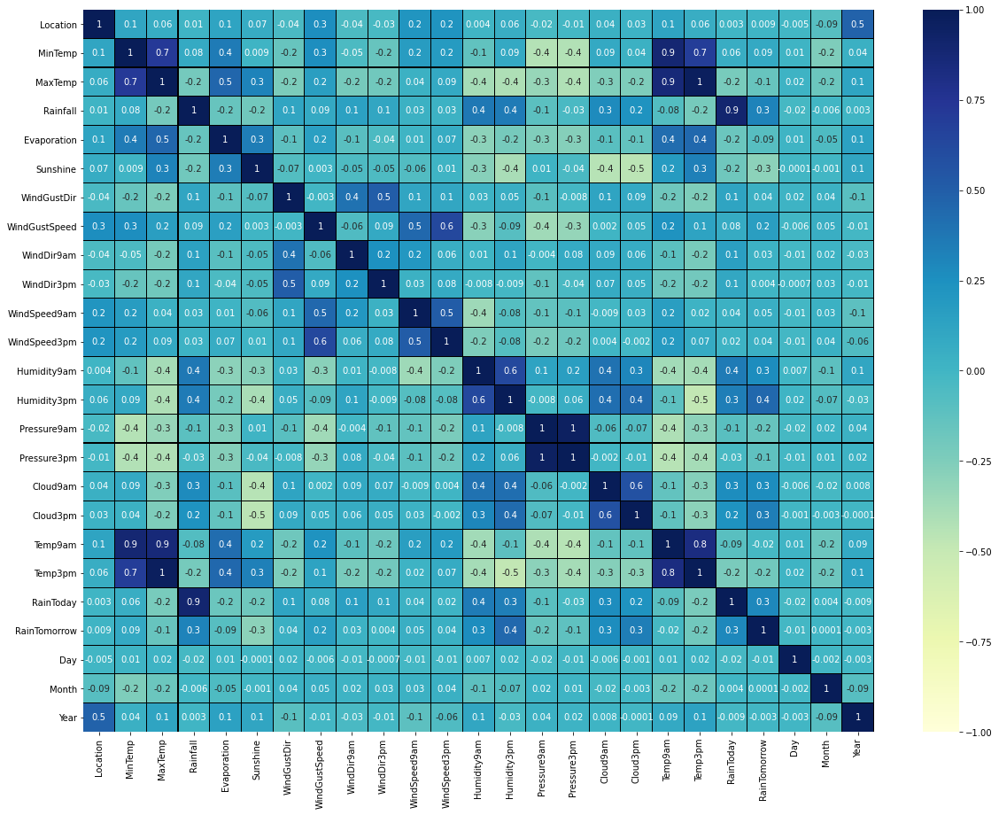

In [54]:
plt.figure(figsize=(20,15))    
sns.heatmap(new_df.corr(),linewidths=.1,vmin=-1, vmax=1,fmt='.1g',linecolor="black",annot=True,annot_kws={'size':10},cmap="YlGnBu")
plt.yticks(rotation=0);

Temp 3 pm , temp 9 am and max temp is highly co related to each other

- we can clearly see that humidy has the highest corelation with raintomorrow.
- Rain today has highly co-related with Rainfall feature.

## Visualizing the correlation between label and features using bar plot

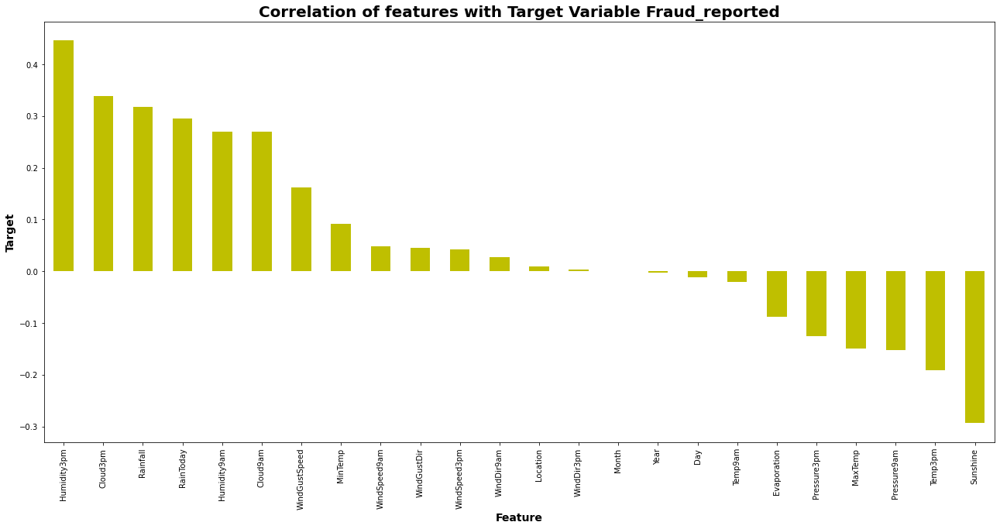

In [55]:
plt.figure(figsize=(22,10))
new_df.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color='y')
plt.xlabel('Feature',fontsize=14,fontweight='bold')
plt.ylabel('Target',fontsize=14,fontweight='bold')
plt.title('Correlation of features with Target Variable Fraud_reported',fontsize=20,fontweight='bold')
plt.show()

## Here We are going to implement Machine Learning Model on our 1st Target feature, i.e. RainTomorrow 

## Data Pre-Processing

In [56]:
# Splitting data in target and dependent feature
X = new_df.drop(['RainTomorrow'], axis =1)
Y = new_df['RainTomorrow']

In [57]:
Y.value_counts()

0    6165
1    1822
Name: RainTomorrow, dtype: int64

**As we see here data is imabalance of our target variable. Before train our dataset we need to do data balancing of our target feature**

In [58]:
# Oversampleing using SMOTE Techniques( for data balancing)
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
X, Y = oversample.fit_resample(X, Y)

In [59]:
Y.value_counts()

0    6165
1    6165
Name: RainTomorrow, dtype: int64

**We have successfully resolved the class imbalanced problem and now all the categories have same data ensuring that the ML model does not get biased towards one category.**

## Now we will scale the data using Standard Scaling

In [69]:
from sklearn.preprocessing import StandardScaler
scaler= StandardScaler()
X_scale = scaler.fit_transform(X)

## Now Checking Multicollinearity between features using variance_inflation_factor¶

In [70]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X_scale,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,1.581044,Location
1,9.685701,MinTemp
2,25.877660,MaxTemp
3,3.822258,Rainfall
4,1.514540,Evaporation
5,1.676598,Sunshine
6,1.588377,WindGustDir
7,2.163802,WindGustSpeed
8,1.446083,WindDir9am
9,1.502351,WindDir3pm


- As we see that some features having the VIF value more than 10. we are removing/ dropping that features, but this will not work here as most of input features are correlated with each other either moderated or poorly.

- Another way to address Multicollinerity is to Scaled Data and then apply PCA.

**We will go by Second way for further investigation. As far some Independent feature VIF is exceed permissible limit of 10.**

## PCA 

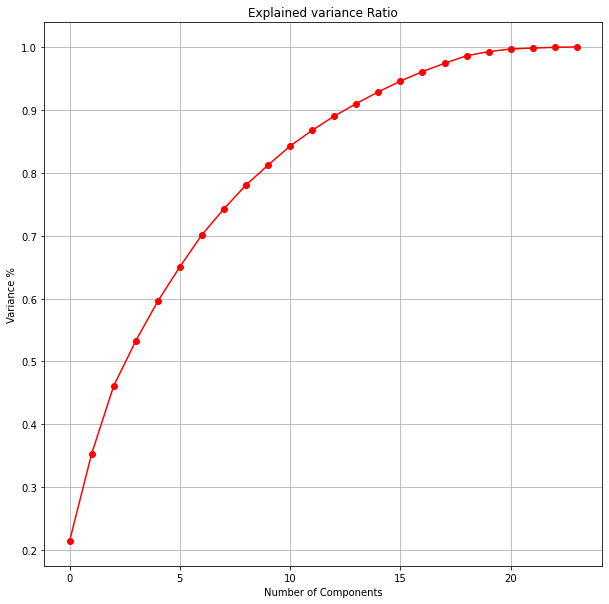

In [71]:
from sklearn.decomposition import PCA
pca = PCA()
#plot the graph to find the principal components
x_pca = pca.fit_transform(X_scale)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

**Comment** 
- AS per the graph, we can see that 13 principal components attribute for 90% of variation in the data. We shall pick the first 13 components for our prediction.

In [72]:
pca_new = PCA(n_components=13)
x_new = pca_new.fit_transform(X_scale)

In [73]:
principle_x=pd.DataFrame(x_new,columns=np.arange(13))

## Implementing Classification Model on our Target Variable (RainfallTomorrow)

In [75]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score

In [76]:
X_train, X_test, Y_train, Y_test = train_test_split(principle_x, Y, random_state=199, test_size=.3)
print('Training feature matrix size:',X_train.shape)
print('Training target vector size:',Y_train.shape)
print('Test feature matrix size:',X_test.shape)
print('Test target vector size:',Y_test.shape)

Training feature matrix size: (8631, 13)
Training target vector size: (8631,)
Test feature matrix size: (3699, 13)
Test target vector size: (3699,)


In [77]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
maxAccu=0
maxRS=0
for i in range(1,250):
    X_train,X_test,Y_train,Y_test = train_test_split(principle_x,Y,test_size = 0.3, random_state=i)
    log_reg=LogisticRegression()
    log_reg.fit(X_train,Y_train)
    y_pred=log_reg.predict(X_test)
    acc=accuracy_score(Y_test,y_pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print('Best accuracy is', maxAccu ,'on Random_state', maxRS)

Best accuracy is 0.7642606109759394 on Random_state 139


In [78]:
X_train, X_test, Y_train, Y_test = train_test_split(principle_x, Y, random_state=139, test_size=.3)
log_reg=LogisticRegression()
log_reg.fit(X_train,Y_train)
y_pred=log_reg.predict(X_test)
print('\033[1m'+'Logistics Regression Evaluation'+'\033[0m')
print('\n')
print('\033[1m'+'Accuracy Score of Logistics Regression :'+'\033[0m', accuracy_score(Y_test, y_pred))
print('\n')
print('\033[1m'+'Confusion matrix of Logistics Regression :'+'\033[0m \n',confusion_matrix(Y_test, y_pred))
print('\n')
print('\033[1m'+'classification Report of Logistics Regression'+'\033[0m \n',classification_report(Y_test, y_pred))

Logistics Regression Evaluation


Accuracy Score of Logistics Regression : 0.7642606109759394


Confusion matrix of Logistics Regression : 
 [[1437  397]
 [ 475 1390]]


classification Report of Logistics Regression 
               precision    recall  f1-score   support

           0       0.75      0.78      0.77      1834
           1       0.78      0.75      0.76      1865

    accuracy                           0.76      3699
   macro avg       0.76      0.76      0.76      3699
weighted avg       0.76      0.76      0.76      3699



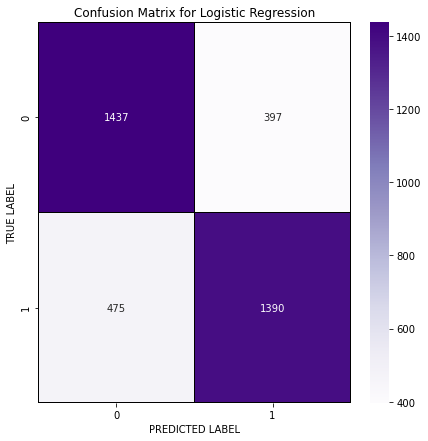

In [79]:
cm = confusion_matrix(Y_test, y_pred)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(7,7))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Purples", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Logistic Regression')
plt.show()

In [80]:
from sklearn.model_selection import cross_val_score
CVscore = cross_val_score(log_reg, principle_x, Y, cv =5)
print('\033[1m'+'Cross Validation Score', log_reg, ':'+'\033[0m\n')
print("CVScore :" ,CVscore)
print("Mean CV Score :",CVscore.mean())
print("Std deviation :",CVscore.std())

Cross Validation Score LogisticRegression() :

CVScore : [0.68410381 0.69424169 0.62773723 0.72343877 0.78507705]
Mean CV Score : 0.702919708029197
Std deviation : 0.05148322413938983


## finding Best value of K for KNearest Neighbors Values

In [81]:
from sklearn import neighbors
from math import sqrt
from sklearn.metrics import mean_squared_error
rmse_val = [] #to store rmse values for different k
for K in range(12):
    K = K+1
    model = neighbors.KNeighborsClassifier(n_neighbors = K)

    model.fit(X_train,Y_train)  #fit the model
    y_pred=model.predict(X_test) #make prediction on test set
    error = sqrt(mean_squared_error(Y_test,y_pred)) #calculate rmse
    rmse_val.append(error) #store rmse values
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 0.2964145479087509
RMSE value for k=  2 is: 0.3132644744961457
RMSE value for k=  3 is: 0.3537922619066491
RMSE value for k=  4 is: 0.35187675101495286
RMSE value for k=  5 is: 0.3738549247114559
RMSE value for k=  6 is: 0.37781117165511774
RMSE value for k=  7 is: 0.3990391270610635
RMSE value for k=  8 is: 0.3928944449556315
RMSE value for k=  9 is: 0.40542415851840174
RMSE value for k=  10 is: 0.4067556043307839
RMSE value for k=  11 is: 0.40708778536150897
RMSE value for k=  12 is: 0.40442269756066346


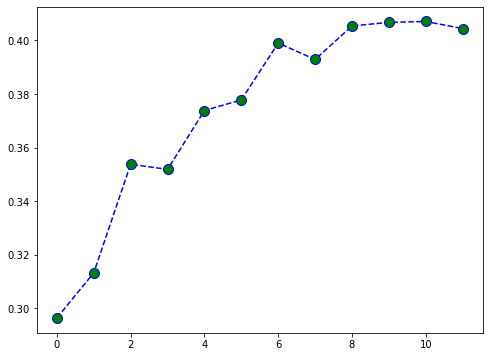

In [83]:
#plotting the rmse values against k values -
plt.figure(figsize = (8,6))
plt.plot(range(12), rmse_val, color='blue', linestyle='dashed', marker='o', markerfacecolor='green', markersize=10)

#### Comment- 

- At k=1, we get the minimum RMSE value which approximately 0.2964145479087509, and shoots up on further increasing the k value. We can safely say that k=1 will give us the best result in this case

## Here we are going Implement other Classification Machine Learning Model

Classification ML Algorithm Evaluation Matrix LogisticRegression() is


Accuracy Score :
 0.7642606109759394


Confusion matrix : 
 [[1437  397]
 [ 475 1390]]


Classification Report : 
               precision    recall  f1-score   support

           0       0.75      0.78      0.77      1834
           1       0.78      0.75      0.76      1865

    accuracy                           0.76      3699
   macro avg       0.76      0.76      0.76      3699
weighted avg       0.76      0.76      0.76      3699



Cross Validation Score LogisticRegression() :

CVScore : [0.68410381 0.69424169 0.62773723 0.72343877 0.78507705]
Mean CV Score : 0.702919708029197
Std deviation : 0.05148322413938983


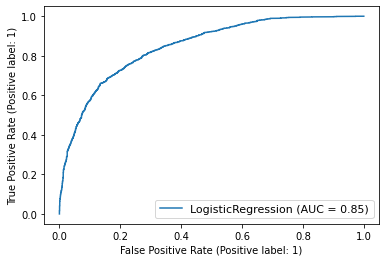

Classification ML Algorithm Evaluation Matrix SVC() is


Accuracy Score :
 0.8304947283049473


Confusion matrix : 
 [[1477  357]
 [ 270 1595]]


Classification Report : 
               precision    recall  f1-score   support

           0       0.85      0.81      0.82      1834
           1       0.82      0.86      0.84      1865

    accuracy                           0.83      3699
   macro avg       0.83      0.83      0.83      3699
weighted avg       0.83      0.83      0.83      3699



Cross Validation Score SVC() :

CVScore : [0.66017843 0.61557178 0.72141119 0.78223844 0.78669911]
Mean CV Score : 0.7132197891321979
Std deviation : 0.06719881621088752


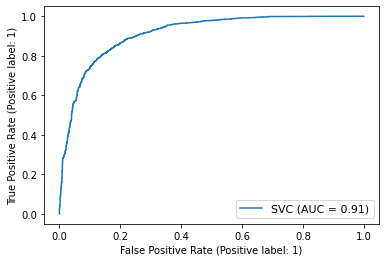

Classification ML Algorithm Evaluation Matrix GaussianNB() is


Accuracy Score :
 0.7607461476074615


Confusion matrix : 
 [[1391  443]
 [ 442 1423]]


Classification Report : 
               precision    recall  f1-score   support

           0       0.76      0.76      0.76      1834
           1       0.76      0.76      0.76      1865

    accuracy                           0.76      3699
   macro avg       0.76      0.76      0.76      3699
weighted avg       0.76      0.76      0.76      3699



Cross Validation Score GaussianNB() :

CVScore : [0.69545823 0.60340633 0.61192214 0.72100568 0.78021087]
Mean CV Score : 0.6824006488240065
Std deviation : 0.06698508895534759


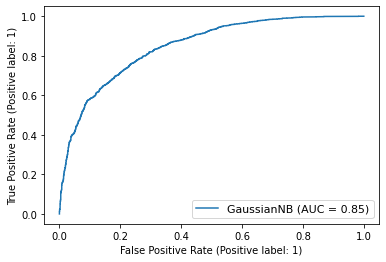

Classification ML Algorithm Evaluation Matrix DecisionTreeClassifier() is


Accuracy Score :
 0.8242768315761017


Confusion matrix : 
 [[1478  356]
 [ 294 1571]]


Classification Report : 
               precision    recall  f1-score   support

           0       0.83      0.81      0.82      1834
           1       0.82      0.84      0.83      1865

    accuracy                           0.82      3699
   macro avg       0.82      0.82      0.82      3699
weighted avg       0.82      0.82      0.82      3699



Cross Validation Score DecisionTreeClassifier() :

CVScore : [0.67599351 0.70437956 0.84712084 0.82278994 0.75344688]
Mean CV Score : 0.7607461476074615
Std deviation : 0.06591434025362526


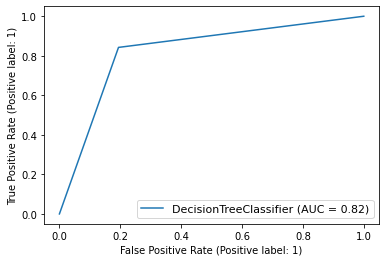

Classification ML Algorithm Evaluation Matrix KNeighborsClassifier(n_neighbors=3) is


Accuracy Score :
 0.874831035414977


Confusion matrix : 
 [[1475  359]
 [ 104 1761]]


Classification Report : 
               precision    recall  f1-score   support

           0       0.93      0.80      0.86      1834
           1       0.83      0.94      0.88      1865

    accuracy                           0.87      3699
   macro avg       0.88      0.87      0.87      3699
weighted avg       0.88      0.87      0.87      3699



Cross Validation Score KNeighborsClassifier(n_neighbors=3) :

CVScore : [0.73154907 0.67923763 0.79927007 0.81670722 0.78953771]
Mean CV Score : 0.7632603406326034
Std deviation : 0.05081179054532311


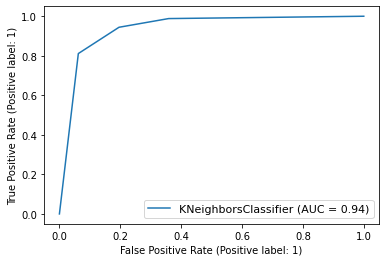

Classification ML Algorithm Evaluation Matrix RandomForestClassifier() is


Accuracy Score :
 0.9032170856988375


Confusion matrix : 
 [[1637  197]
 [ 161 1704]]


Classification Report : 
               precision    recall  f1-score   support

           0       0.91      0.89      0.90      1834
           1       0.90      0.91      0.90      1865

    accuracy                           0.90      3699
   macro avg       0.90      0.90      0.90      3699
weighted avg       0.90      0.90      0.90      3699



Cross Validation Score RandomForestClassifier() :

CVScore : [0.71248986 0.75628548 0.85482563 0.89091646 0.85117599]
Mean CV Score : 0.813138686131387
Std deviation : 0.06722572895366737


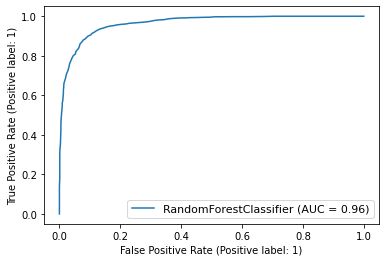

Classification ML Algorithm Evaluation Matrix ExtraTreesClassifier() is


Accuracy Score :
 0.9197080291970803


Confusion matrix : 
 [[1657  177]
 [ 120 1745]]


Classification Report : 
               precision    recall  f1-score   support

           0       0.93      0.90      0.92      1834
           1       0.91      0.94      0.92      1865

    accuracy                           0.92      3699
   macro avg       0.92      0.92      0.92      3699
weighted avg       0.92      0.92      0.92      3699



Cross Validation Score ExtraTreesClassifier() :

CVScore : [0.76155718 0.7648013  0.86050284 0.90348743 0.85604217]
Mean CV Score : 0.8292781832927819
Std deviation : 0.05646539793609274


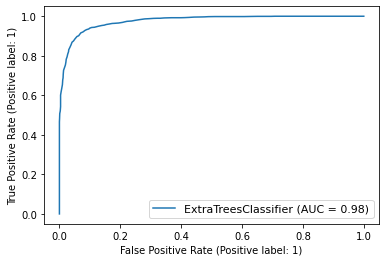

In [86]:
from sklearn.metrics import plot_roc_curve
model=[ LogisticRegression(),
        SVC(),
        GaussianNB(),
        DecisionTreeClassifier(),
        KNeighborsClassifier(n_neighbors = 3),
        RandomForestClassifier(),
        ExtraTreesClassifier()]
       
    
for m in model:
    m.fit(X_train,Y_train)
    y_pred=m.predict(X_test)
    print('\033[1m'+'Classification ML Algorithm Evaluation Matrix',m,'is' +'\033[0m')
    print('\n')
    print('\033[1m'+'Accuracy Score :'+'\033[0m\n', accuracy_score(Y_test, y_pred))
    print('\n')
    print('\033[1m'+'Confusion matrix :'+'\033[0m \n',confusion_matrix(Y_test, y_pred))
    print('\n')
    print('\033[1m'+'Classification Report :'+'\033[0m \n',classification_report(Y_test, y_pred))
    print('\n')
    
    
    
    CVscore = cross_val_score(m, principle_x, Y, cv =5)
    print('\033[1m'+'Cross Validation Score', m, ':'+'\033[0m\n')
    print("CVScore :" ,CVscore)
    print("Mean CV Score :",CVscore.mean())
    print("Std deviation :",CVscore.std())
    
    
    
    
    disp = plot_roc_curve(m,X_test,Y_test)   
    plt.legend(prop={'size':11}, loc='lower right')
    plt.show()
    print('============================================================================================================')
    
    
    

## Here  Implementing  Confusion matrix for other Classification Model

Confusion Matrix LogisticRegression() is


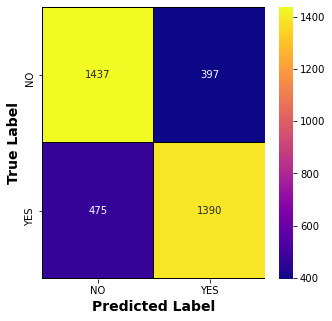

Confusion Matrix SVC() is


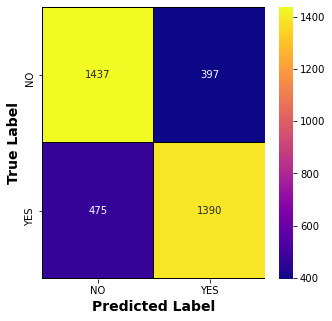

Confusion Matrix GaussianNB() is


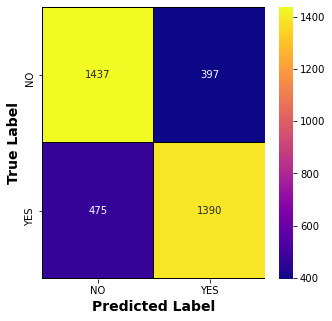

Confusion Matrix DecisionTreeClassifier() is


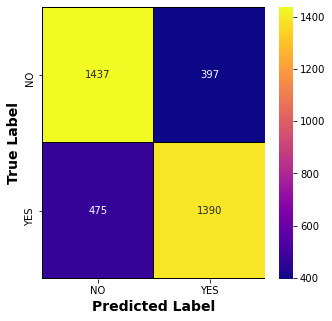

Confusion Matrix KNeighborsClassifier(n_neighbors=3) is


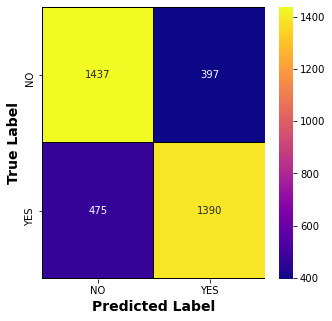

Confusion Matrix RandomForestClassifier() is


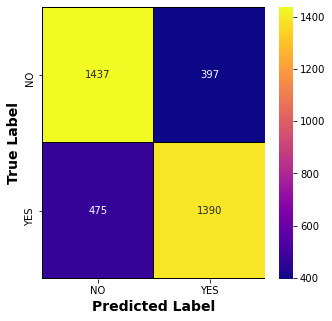

Confusion Matrix ExtraTreesClassifier() is


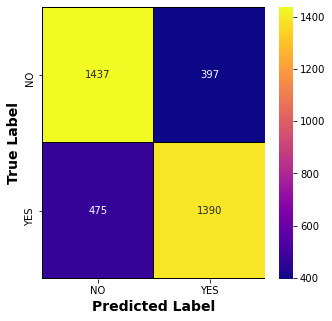

In [87]:
model=[ LogisticRegression(),
        SVC(),
        GaussianNB(),
        DecisionTreeClassifier(),
        KNeighborsClassifier(n_neighbors = 3),
        RandomForestClassifier(),
        ExtraTreesClassifier()]
       

for m in model:
    Matrix = confusion_matrix(Y_test, y_pred)
    x_labels = ["NO","YES"]
    y_labels = ["NO","YES"]

    fig , ax = plt.subplots(figsize=(5,5))
    sns.heatmap(Matrix, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, 
            cmap="plasma", xticklabels = x_labels, yticklabels = y_labels)

    plt.xlabel("Predicted Label",fontsize=14,fontweight='bold')
    plt.ylabel("True Label",fontsize=14,fontweight='bold')
    plt.title( print('\033[1m'+'Confusion Matrix',m,'is' +'\033[0m'),fontsize=20,fontweight='bold')
    plt.show()

**AS we see the output of various model we get the idea that  we got the best accuracy and F1score from ExtraTreesClassifier**

**So, Now we will do hyper para tunning on our best model, i.e **ExtraTreesClassifier.**

## Here We implementing Hyper Para Tunning Model using GridSearchCV

In [88]:
from sklearn.model_selection import GridSearchCV

In [89]:
parameter= {'criterion' : ['gini', 'entropy'],
             'max_features':['auto','sqrt','log2'],
              'min_samples_split':[3,5,8,11],
              'max_depth' : [10,20,30],
              'n_estimators' : [100,200,300,400]
             }

In [90]:
GCV = GridSearchCV(ExtraTreesClassifier(),parameter,verbose=10)
GCV.fit(X_train,Y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV 1/5; 1/288] START criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100
[CV 1/5; 1/288] END criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100;, score=0.805 total time=   0.6s
[CV 2/5; 1/288] START criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100
[CV 2/5; 1/288] END criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100;, score=0.790 total time=   0.9s
[CV 3/5; 1/288] START criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100
[CV 3/5; 1/288] END criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100;, score=0.795 total time=   0.7s
[CV 4/5; 1/288] START criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100
[CV 4/5; 1/288] END criterion=gini, max_depth=10, max_features=auto, min_samples

GridSearchCV(estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [10, 20, 30],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'min_samples_split': [3, 5, 8, 11],
                         'n_estimators': [100, 200, 300, 400]},
             verbose=10)

In [91]:
GCV.best_params_

{'criterion': 'gini',
 'max_depth': 30,
 'max_features': 'sqrt',
 'min_samples_split': 3,
 'n_estimators': 400}

In [92]:
Final_mod = ExtraTreesClassifier(criterion='gini',n_estimators= 400, max_depth=30 ,
                                 min_samples_split= 3, max_features= 'sqrt')
Final_mod.fit(X_train,Y_train)
y_pred=Final_mod.predict(X_test)
print('\033[1m'+'Accuracy Score :'+'\033[0m\n', accuracy_score(Y_test, y_pred))
print('\n')
print('\033[1m'+'Confusion matrix of Extra Trees Classifier :'+'\033[0m \n',confusion_matrix(Y_test, y_pred))
print('\n')
print('\033[1m'+'Classification Report of Extra Trees Classifier'+'\033[0m \n',classification_report(Y_test, y_pred))

Accuracy Score :
 0.9188969991889699


Confusion matrix of Extra Trees Classifier : 
 [[1645  189]
 [ 111 1754]]


Classification Report of Extra Trees Classifier 
               precision    recall  f1-score   support

           0       0.94      0.90      0.92      1834
           1       0.90      0.94      0.92      1865

    accuracy                           0.92      3699
   macro avg       0.92      0.92      0.92      3699
weighted avg       0.92      0.92      0.92      3699



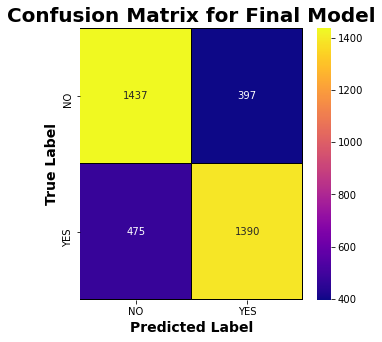

In [93]:
# Lets plot confusion matrix for  FinalModel
Matrix = confusion_matrix(Y_test, y_pred)

x_labels = ["NO","YES"]
y_labels = ["NO","YES"]

fig , ax = plt.subplots(figsize=(5,5))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, 
            cmap="plasma", xticklabels = x_labels, yticklabels = y_labels)

plt.xlabel("Predicted Label",fontsize=14,fontweight='bold')
plt.ylabel("True Label",fontsize=14,fontweight='bold')
plt.title('Confusion Matrix for Final Model',fontsize=20,fontweight='bold')
plt.show()

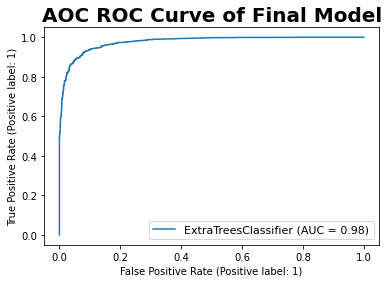

Auc Score :
 0.9187145693060189


In [94]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import plot_roc_curve
disp = plot_roc_curve(Final_mod,X_test,Y_test)   
plt.legend(prop={'size':11}, loc='lower right')
plt.title('AOC ROC Curve of Final Model',fontsize=20,fontweight='bold')
plt.show()
auc_score = roc_auc_score(Y_test, Final_mod.predict(X_test))
print('\033[1m'+'Auc Score :'+'\033[0m\n',auc_score)

## Conclusion:

__Here we got the best accuracy of 91.87 on our final model for classification Problem__

## Saving Final Model

In [95]:
import joblib
joblib.dump(Final_mod,'Rainfall_Tomorrow_Prediction_Final_classification_model.pkl')

['Rainfall_Tomorrow_Prediction_Final_classification_model.pkl']

In [48]:
print('=========================================================================================================================')

#### Now we will try to explore our  target rainfall, which having continous value, and in further steps we will build the regression model on it. 

In [51]:
new_df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.4,22.9,0.6,5.389395,7.632205,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,No,No,1,12,2008
1,Albury,7.4,25.1,0.0,5.389395,7.632205,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,No,No,2,12,2008
2,Albury,12.9,25.7,0.0,5.389395,7.632205,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,No,No,3,12,2008
3,Albury,9.2,28.0,0.0,5.389395,7.632205,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,No,No,4,12,2008
4,Albury,17.5,32.3,1.0,5.389395,7.632205,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,5,12,2008


## Spliting the data

In [59]:
# Splitting data in target and dependent feature
X = new_df.drop(['Rainfall'], axis =1)
Y = new_df['Rainfall']

In [60]:
Y.value_counts()

0.000000    5303
0.182322     390
0.336472     176
0.470004     115
0.788457      82
0.875469      79
0.587787      77
0.693147      74
1.029619      65
1.098612      57
0.955511      55
1.223775      46
1.568616      46
1.280934      45
1.163151      41
1.386294      38
1.757858      37
1.335001      36
1.435085      35
1.481605      34
1.526056      33
1.648659      33
1.609438      33
1.791759      32
0.095310      28
1.945910      26
1.686399      25
1.824549      24
2.322388      24
1.722767      24
2.054124      24
1.974081      23
2.197225      22
2.104134      21
2.079442      19
1.887070      19
2.501436      18
2.451005      18
2.261763      16
2.001480      16
1.916923      16
2.219203      16
2.151762      16
2.484907      15
2.174752      15
2.128232      14
2.653242      14
2.341806      14
2.833213      13
2.028148      13
2.624669      12
2.809403      12
1.856298      12
2.397895      11
2.433613      11
2.517696      11
2.282382      11
2.549445      11
2.639057      

## Now scalling the data using Standscaler tool

In [61]:
from sklearn.preprocessing import StandardScaler
scaler= StandardScaler()
X_scale = scaler.fit_transform(X)

## Checking Multicolinearity using VIF

In [62]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X_scale,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,1.602216,Location
1,8.776052,MinTemp
2,26.340651,MaxTemp
3,1.505386,Evaporation
4,1.647674,Sunshine
5,1.623987,WindGustDir
6,2.216485,WindGustSpeed
7,1.396968,WindDir9am
8,1.495284,WindDir3pm
9,1.814908,WindSpeed9am


- As we see that some features having the VIF value more than 10. we are removing/ dropping that features, but this will not work here as most of input features are correlated with each other either moderated or poorly.

- Another way to address Multicollinerity is to Scaled Data and then apply PCA

## Applying PCA

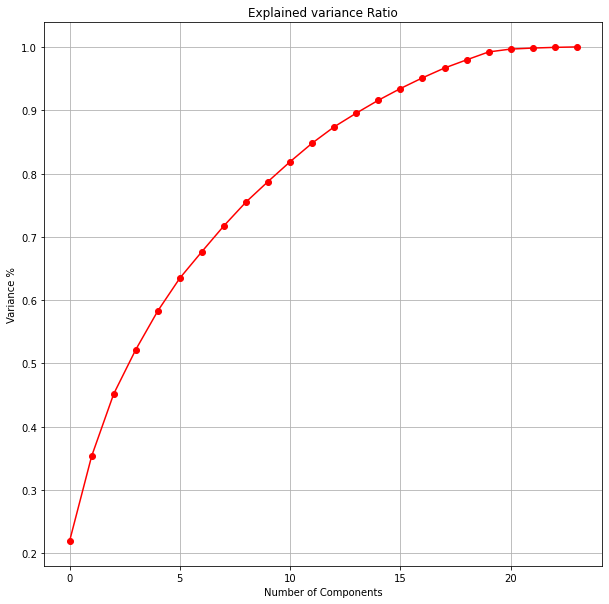

In [63]:
from sklearn.decomposition import PCA
pca = PCA()
#plot the graph to find the principal components
x_pca = pca.fit_transform(X_scale)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

**Comment** 
- AS per the graph, we can see that 13 principal components attribute for 90% of variation in the data. We shall pick the first 13 components for our prediction.

In [64]:
pca_new = PCA(n_components=13)
x_new = pca_new.fit_transform(X_scale)

In [65]:
principle_x=pd.DataFrame(x_new,columns=np.arange(13))

## Building Machine Learning Model for Regression Algorithm.

In [66]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import  GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import  Ridge
from sklearn.linear_model import  Lasso

In [67]:
X_train, X_test, Y_train, Y_test = train_test_split(principle_x, Y, random_state=199, test_size=.3)
print('Training feature matrix size:',X_train.shape)
print('Training target vector size:',Y_train.shape)
print('Test feature matrix size:',X_test.shape)
print('Test target vector size:',Y_test.shape)

Training feature matrix size: (5590, 13)
Training target vector size: (5590,)
Test feature matrix size: (2397, 13)
Test target vector size: (2397,)


## Finding Best Random State 

In [68]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
maxR2_score=0
maxRS=0
for i in range(1,200):
    X_train, X_test, Y_train, Y_test = train_test_split(principle_x, Y, random_state=i, test_size=.33)
    lin_reg=LinearRegression()
    lin_reg.fit(X_train,Y_train)
    y_pred=lin_reg.predict(X_test)
    R2=r2_score(Y_test,y_pred)
    if R2>maxR2_score:
        maxR2_score=R2
        maxRS=i
print('Best R2 Score is', maxR2_score ,'on Random_state', maxRS)

Best R2 Score is 0.8148202401279984 on Random_state 143


## Linear Regression Model

In [69]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(principle_x, Y, random_state=143, test_size=.3)
lin_reg=LinearRegression()
lin_reg.fit(X_train,Y_train)
lin_reg.score(X_train,Y_train)
y_pred=lin_reg.predict(X_test)
print('\033[1m'+'Predicted Wins:'+'\033[0m\n',y_pred)
print('\n')
print('\033[1m'+'Actual Wins:'+'\033[0m\n',Y_test)

Predicted Wins:
 [-0.32904458  0.04732837 -0.30576989 ... -0.13422164 -0.04666063
  0.03306192]


Actual Wins:
 4496    0.000000
3884    0.000000
4484    0.000000
6273    0.000000
2758    2.517696
2534    0.000000
1547    0.000000
2549    0.000000
3994    0.000000
442     0.000000
6356    0.000000
1105    0.000000
1287    0.000000
2489    0.470004
6292    0.000000
1781    0.000000
1034    0.000000
1194    0.000000
2007    0.000000
4570    0.000000
2174    0.000000
7218    0.000000
3336    1.481605
4980    0.000000
2509    0.000000
3482    0.000000
2195    0.000000
7164    0.470004
4524    0.788457
8084    0.000000
8374    0.000000
3937    2.128232
3700    0.000000
7723    0.000000
698     1.481605
1875    0.095310
2695    0.000000
7507    0.000000
2554    0.000000
5815    0.000000
3196    0.470004
6923    0.000000
3724    0.587787
2403    0.000000
2973    0.000000
7488    0.000000
4517    2.933857
4625    1.280934
2556    0.000000
2694    0.000000
4700    0.000000
3353    1.280934
5883

In [70]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score
print('\033[1m'+' Error :'+'\033[0m')
print('Mean absolute error :', mean_absolute_error(Y_test,y_pred))
print('Mean squared error :', mean_squared_error(Y_test,y_pred))
print('Root Mean Squared Error:', np.sqrt(mean_squared_error(Y_test,y_pred)))
print('\n')
from sklearn.metrics import r2_score
print('\033[1m'+' R2 Score :'+'\033[0m')
print(r2_score(Y_test,y_pred,multioutput='variance_weighted'))

 Error :
Mean absolute error : 0.2441000657489825
Mean squared error : 0.1374518294735114
Root Mean Squared Error: 0.3707449655403447


 R2 Score :
0.8142911023254551


## Implmenting other ML models of Regression Algorithm

In [71]:
from xgboost import XGBRegressor
from sklearn.ensemble import ExtraTreesRegressor

rf = RandomForestRegressor()
dtc = DecisionTreeRegressor()
adb=AdaBoostRegressor(learning_rate=0.1)
gradb=GradientBoostingRegressor()
rd=Ridge(alpha=0.01)
xgb=XGBRegressor()
svr=SVR()
ETR=ExtraTreesRegressor()

model = [rf,rd,dtc,adb,gradb,xgb,svr,ETR]

for m in model:
    X_train, X_test, Y_train, Y_test = train_test_split(principle_x, Y, random_state=143, test_size=.3)
    m.fit(X_train,Y_train)
    m.score(X_train,Y_train)
    y_pred = m.predict(X_test)
    print('\n')                                        
    print('\033[1m'+' Error of ', m, ':' +'\033[0m')
    print('Mean absolute error :', mean_absolute_error(Y_test,y_pred))
    print('Mean squared error :', mean_squared_error(Y_test,y_pred))
    print('Root Mean Squared Error:', np.sqrt(mean_squared_error(Y_test,y_pred)))
    print('\n')

    print('\033[1m'+' R2 Score :'+'\033[0m')
    print(r2_score(Y_test,y_pred)) 
    print('==============================================================================================================')



 Error of  RandomForestRegressor() :
Mean absolute error : 0.19310492049979933
Mean squared error : 0.12770686828779346
Root Mean Squared Error: 0.3573609775672121


 R2 Score :
0.8274573585085324


 Error of  Ridge(alpha=0.01) :
Mean absolute error : 0.2441000892124686
Mean squared error : 0.1374518721962967
Root Mean Squared Error: 0.3707450231578257


 R2 Score :
0.8142910446034052


 Error of  DecisionTreeRegressor() :
Mean absolute error : 0.21038296582243127
Mean squared error : 0.2737640655233021
Root Mean Squared Error: 0.5232246797727551


 R2 Score :
0.6301218905126915


 Error of  AdaBoostRegressor(learning_rate=0.1) :
Mean absolute error : 0.34459225056969556
Mean squared error : 0.23299149870531957
Root Mean Squared Error: 0.48269192939733263


 R2 Score :
0.6852090324454836


 Error of  GradientBoostingRegressor() :
Mean absolute error : 0.23807303990814738
Mean squared error : 0.14805388157898122
Root Mean Squared Error: 0.38477770410846474


 R2 Score :
0.799966844750

**by comparing the R2score score of various model, we got the best R2score of 85.95 from ExtraTreesRegressor model, so in further steps we will do hyper parameter tunning on it.**

## Hyper Parameter Tunning : GridSearchCV

In [72]:
from sklearn.model_selection import GridSearchCV

In [73]:
param = {'criterion' : ['squared_error'],
              'min_samples_split':[2,4,6,8,10],
              'max_depth' : [20,30,40,60,80,100,None],
              'n_estimators' : [100, 150, 200,250,300],
               'max_features':['auto']}

In [74]:
GCV = GridSearchCV(ExtraTreesRegressor(),param,verbose=10)
GCV.fit(X_train,Y_train)

Fitting 5 folds for each of 175 candidates, totalling 875 fits
[CV 1/5; 1/175] START criterion=squared_error, max_depth=20, max_features=auto, min_samples_split=2, n_estimators=100
[CV 1/5; 1/175] END criterion=squared_error, max_depth=20, max_features=auto, min_samples_split=2, n_estimators=100;, score=0.838 total time=   1.1s
[CV 2/5; 1/175] START criterion=squared_error, max_depth=20, max_features=auto, min_samples_split=2, n_estimators=100
[CV 2/5; 1/175] END criterion=squared_error, max_depth=20, max_features=auto, min_samples_split=2, n_estimators=100;, score=0.833 total time=   1.1s
[CV 3/5; 1/175] START criterion=squared_error, max_depth=20, max_features=auto, min_samples_split=2, n_estimators=100
[CV 3/5; 1/175] END criterion=squared_error, max_depth=20, max_features=auto, min_samples_split=2, n_estimators=100;, score=0.836 total time=   1.1s
[CV 4/5; 1/175] START criterion=squared_error, max_depth=20, max_features=auto, min_samples_split=2, n_estimators=100
[CV 4/5; 1/175] EN

GridSearchCV(estimator=ExtraTreesRegressor(),
             param_grid={'criterion': ['squared_error'],
                         'max_depth': [20, 30, 40, 60, 80, 100, None],
                         'max_features': ['auto'],
                         'min_samples_split': [2, 4, 6, 8, 10],
                         'n_estimators': [100, 150, 200, 250, 300]},
             verbose=10)

In [75]:
GCV.best_params_

{'criterion': 'squared_error',
 'max_depth': 80,
 'max_features': 'auto',
 'min_samples_split': 2,
 'n_estimators': 200}

## Final Model

In [78]:
Final_Model = ExtraTreesRegressor(criterion='squared_error',max_depth=80,max_features='auto',min_samples_split=2,n_estimators=200)
Classifier = Final_Model.fit(X_train, Y_train)
fmod_pred = Final_Model.predict(X_test)
fmod_r2 = r2_score(Y_test, fmod_pred, multioutput='variance_weighted')*100
print("R2 score for the Best Model is:", fmod_r2)

R2 score for the Best Model is: 86.16955752028406


In [79]:
# Cross Validation Score

from sklearn.model_selection import cross_val_score
cv_score = (cross_val_score(Final_Model, principle_x, Y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
# Result of r2 score minus cv score
result = fmod_r2 - cv_score
print("R2 Score - Cross Validation Score is", result)

Cross Validation Score: 83.12469492490877
R2 Score - Cross Validation Score is 3.0448625953752924


## Prediction base on our Final Model

 True Values Vs Predicted Value plot :


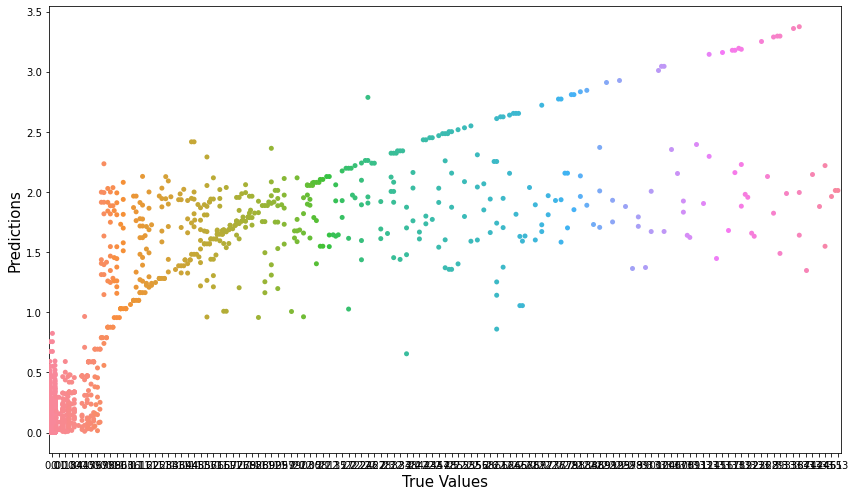

In [80]:
plt.figure(figsize=(12,7))
y_pred=Final_Model.predict(X_test)
sns.swarmplot(Y_test.round(2), y_pred)
print('\033[1m'+' True Values Vs Predicted Value plot :' +'\033[0m')
plt.xlabel('True Values' , fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.tight_layout()

## Finding best features of our Final Model

<AxesSubplot:>

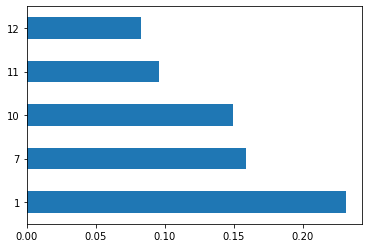

In [81]:
feat_importances = pd.Series(Final_Model.feature_importances_, index=principle_x.columns)
feat_importances = feat_importances.nlargest()
feat_importances.plot(kind='barh')

## Saving the final Model

In [82]:
import joblib
joblib.dump(Final_Model,"Rainfall_prediction_Regression_model.pkl")

['Rainfall_prediction_Regression_model.pkl']

## Summarizing the Project Report:

**1. I have imported necessary liabries like pandas, numpy , matplotlib to load the dataset and to check some stastical features.**

**2. After loading data set I have checked shape of dataset, data types from which we will able to decide which is our target variable and which features affecting the target features.**

**3. Missing value checked, and missing value filled by using median function, also we have droped some cloumns which having are not affecting to our target variable.**

**4. after finding the data types we have distribute the dataset into two features 1. categorical and 2. numerical features, so it helps us to further pre processing on data set.**

**5. after this we have done exploratives data analysis by using various plots(like pie charts, crosstrab, barchart, scatter plot, volin plot etc) base on our target variable /feature i.e income**

**6. Now we have done the feature engineering on dataset by using label encoding.**

**7. after that check the correlation of various feature with target feature and non correlated features we have drop in further steps.**

**8.after checking malticolinearity we found that its below 10 i.e permissible/ acceptable so we have not drop any features in multicolinearlity.**

**9. Also we have done the data balacing using SMOTE oversampling feature for classification Problem**

**10. afterwards implemented various machine learning model for classification and regression algorithm where taken the sampling ratio as 70: 30.**

**11. Indentified the final model  base on highest accuracy, F1 score in classification alogrithm and for regression algorithm we have considered R2score.**

**12. Afterwards deployed hyper parameter tunning on best model using gridsearchCV for both algorithm.**

**13. Afterwards we have save the final model and plotted the AOC and Roc plot on final model for classification Algorithm and also save the final model for regression model.**

